Load libraries

In [5]:
import numpy
import scanpy as sc
import matplotlib.pyplot as plt

In [6]:
import dandelion as ddl #Be sure that networkx==2.5
ddl.logging.print_header()

dandelion==0.3.8 pandas==2.2.2 numpy==1.24.3 matplotlib==3.9.1.post1 networkx==3.1 scipy==1.11.1


In [ ]:
import dandelion as ddl
import scanpy as sc
import warnings
import os

warnings.filterwarnings("ignore")
ddl.logging.print_header()

In [8]:
samples = ['GAD_CSF_9910_filtered', 'GAD_CSF_9961_filtered', 'GAD_CSF_R3_filtered', 'GAD_CSF_R14_filtered', 'GAD_PBMC_9910_filtered', 'GAD_PBMC_9961_filtered', 'GAD_PBMC_R3_filtered', 'GAD_PBMC_R14_filtered']
vdj_list = []
for sample in samples:
    vdj = ddl.read_10x_airr(sample +'/filtered_contig_dandelion.tsv')
    vdj_list.append(vdj)
vdj = ddl.concat(vdj_list)

In [8]:
vdj

Dandelion class object with n_obs = 28978 and n_contigs = 56089
    data: 'sequence_id', 'sequence', 'rev_comp', 'productive', 'v_call', 'd_call', 'j_call', 'sequence_alignment', 'germline_alignment', 'junction', 'junction_aa', 'v_cigar', 'd_cigar', 'j_cigar', 'stop_codon', 'vj_in_frame', 'locus', 'c_call', 'junction_length', 'np1_length', 'np2_length', 'v_sequence_start', 'v_sequence_end', 'v_germline_start', 'v_germline_end', 'd_sequence_start', 'd_sequence_end', 'd_germline_start', 'd_germline_end', 'j_sequence_start', 'j_sequence_end', 'j_germline_start', 'j_germline_end', 'v_score', 'v_identity', 'v_support', 'd_score', 'd_identity', 'd_support', 'j_score', 'j_identity', 'j_support', 'fwr1', 'fwr2', 'fwr3', 'fwr4', 'cdr1', 'cdr2', 'cdr3', 'cell_id', 'consensus_count', 'umi_count', 'v_call_10x', 'd_call_10x', 'j_call_10x', 'junction_10x', 'junction_10x_aa', 'j_support_igblastn', 'j_score_igblastn', 'j_call_igblastn', 'j_call_blastn', 'j_identity_blastn', 'j_alignment_length_blastn'

Load seurat object converted andata object

In [10]:
adata = sc.read("seurat_object_combined_singlets_integrated.h5ad")
adata

AnnData object with n_obs × n_vars = 118492 × 21606
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'mitoPercent', 'riboPercent', 'log10GenesPerUMI', 'cells', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'pANN_0.25_0.2_119', 'doublet_finder', 'pANN_0.25_0.06_24', 'pANN_0.25_0.04_39', 'pANN_0.25_0.02_12', 'pANN_0.25_0.03_91', 'pANN_0.25_0.07_280', 'pANN_0.25_0.22_1074', 'pANN_0.25_0.001_10', 'pANN_0.25_0.04_361', 'pANN_0.25_0.07_34', 'pANN_0.25_0.03_88', 'pANN_0.25_0.07_94', 'pANN_0.25_0.14_932', 'pANN_0.25_0.03_391', 'pANN_0.25_0.28_2189', 'pANN_0.25_0.1_1074', 'pANN_0.25_0.1_171', 'pANN_0.25_0.03_362', 'pANN_0.25_0.01_24', 'pANN_0.25_0.11_345', 'pANN_0.25_0.04_205', 'pANN_0.25_0.07_223', 'pANN_0.25_0.11_438', 'pANN_0.25_0.2_76', 'pANN_0.25_0.23_60', 'pANN_0.25_0.06_25', 'pANN_0.25_0.29_2023', 'pANN_0.25_0.27_1708', 'Disease', 'Sampletype', 'Patient', 'Center', 'samplename', 'harmony_clusters', 'annotate'
    uns: 'annotate_colors'
    obsm: 'umap'

In [11]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,sample,mitoPercent,riboPercent,log10GenesPerUMI,cells,nCount_SCT,nFeature_SCT,...,pANN_0.25_0.06_25,pANN_0.25_0.29_2023,pANN_0.25_0.27_1708,Disease,Sampletype,Patient,Center,samplename,harmony_clusters,annotate
control_CSF_8360_Munich_filtered_AAACCTGCACTTAAGC-1,SeuratProject,4098.0,1234,control_CSF_8360_Munich,2.098585,44.582723,0.855710,AAACCTGCACTTAAGC-1,3621.0,1221,...,NaN,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,1,CD4+ TCM
control_CSF_8360_Munich_filtered_AAAGATGCAGTCAGAG-1,SeuratProject,2439.0,597,control_CSF_8360_Munich,0.000000,52.767528,0.819546,AAAGATGCAGTCAGAG-1,3157.0,593,...,NaN,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,9,cDC1
control_CSF_8360_Munich_filtered_AAAGATGCATGTAAGA-1,SeuratProject,2487.0,977,control_CSF_8360_Munich,2.774427,32.891033,0.880501,AAAGATGCATGTAAGA-1,3103.0,972,...,NaN,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,4,CD8+ TEM
control_CSF_8360_Munich_filtered_AAAGTAGCAAGGTGTG-1,SeuratProject,2997.0,1121,control_CSF_8360_Munich,1.034368,42.542543,0.877159,AAAGTAGCAAGGTGTG-1,3229.0,1111,...,NaN,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,0,CD4+ Naive T
control_CSF_8360_Munich_filtered_AAATGCCAGTACGTTC-1,SeuratProject,3731.0,1109,control_CSF_8360_Munich,0.696864,51.541142,0.852486,AAATGCCAGTACGTTC-1,3511.0,1094,...,NaN,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,0,CD4+ Naive T
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACATTTCACT-1,SeuratProject,3279.0,965,GAD_PBMC_R3_Roterdam,2.561757,52.485514,0.848904,TTTGTCACATTTCACT-1,2927.0,960,...,NaN,NaN,0.143662,GAD,PBMC,R3,Roterdam,GAD_PBMC_R3,8,CD8+ Naive T
GAD_PBMC_R3_Roterdam_filtered_TTTGTCAGTATCGCAT-1,SeuratProject,3133.0,1137,GAD_PBMC_R3_Roterdam,3.734440,38.078519,0.874083,TTTGTCAGTATCGCAT-1,2923.0,1134,...,NaN,NaN,0.240241,GAD,PBMC,R3,Roterdam,GAD_PBMC_R3,10,BC1
GAD_PBMC_R3_Roterdam_filtered_TTTGTCAGTCCCTTGT-1,SeuratProject,2083.0,921,GAD_PBMC_R3_Roterdam,5.040807,29.044647,0.893202,TTTGTCAGTCCCTTGT-1,2482.0,919,...,NaN,NaN,0.238229,GAD,PBMC,R3,Roterdam,GAD_PBMC_R3,3,NK1
GAD_PBMC_R3_Roterdam_filtered_TTTGTCATCCAAGCCG-1,SeuratProject,3764.0,1118,GAD_PBMC_R3_Roterdam,2.284803,50.132837,0.852556,TTTGTCATCCAAGCCG-1,3056.0,1118,...,NaN,NaN,0.142857,GAD,PBMC,R3,Roterdam,GAD_PBMC_R3,0,CD4+ Naive T


First separate the certain population then process further

In [12]:
adata = adata[adata.obs['annotate'].isin(['CD8+ TEM', 'CD4+ Naive T', 'CD4+ Naive T', 'CD8+ TEM, MAIT, gDT', 'CD4+ Naive T', 'CD4+ TCM', 'CD8+ Naive T', 'Activated CD4+ TSCM'])].copy()
adata.obs


,orig.ident,nCount_RNA,nFeature_RNA,sample,mitoPercent,riboPercent,log10GenesPerUMI,cells,nCount_SCT,nFeature_SCT,...,pANN_0.25_0.06_25,pANN_0.25_0.29_2023,pANN_0.25_0.27_1708,Disease,Sampletype,Patient,Center,samplename,harmony_clusters,annotate
control_CSF_8360_Munich_filtered_AAACCTGCACTTAAGC-1,SeuratProject,4098.0,1234,control_CSF_8360_Munich,2.098585,44.582723,0.855710,AAACCTGCACTTAAGC-1,3621.0,1221,...,NaN,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,1,CD4+ TCM
control_CSF_8360_Munich_filtered_AAAGATGCATGTAAGA-1,SeuratProject,2487.0,977,control_CSF_8360_Munich,2.774427,32.891033,0.880501,AAAGATGCATGTAAGA-1,3103.0,972,...,NaN,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,4,CD8+ TEM
control_CSF_8360_Munich_filtered_AAAGTAGCAAGGTGTG-1,SeuratProject,2997.0,1121,control_CSF_8360_Munich,1.034368,42.542543,0.877159,AAAGTAGCAAGGTGTG-1,3229.0,1111,...,NaN,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,0,CD4+ Naive T
control_CSF_8360_Munich_filtered_AAATGCCAGTACGTTC-1,SeuratProject,3731.0,1109,control_CSF_8360_Munich,0.696864,51.541142,0.852486,AAATGCCAGTACGTTC-1,3511.0,1094,...,NaN,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,0,CD4+ Naive T
control_CSF_8360_Munich_filtered_AAATGCCGTTCCAACA-1,SeuratProject,2973.0,1246,control_CSF_8360_Munich,1.950891,31.752439,0.891260,AAATGCCGTTCCAACA-1,3203.0,1231,...,NaN,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,2,"CD8+ TEM, MAIT, gDT"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACAGACTCGC-1,SeuratProject,1323.0,655,GAD_PBMC_R3_Roterdam,2.116402,33.257748,0.902190,TTTGTCACAGACTCGC-1,2449.0,674,...,NaN,NaN,0.192354,GAD,PBMC,R3,Roterdam,GAD_PBMC_R3,1,CD4+ TCM
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACATGGTCTA-1,SeuratProject,4903.0,1379,GAD_PBMC_R3_Roterdam,3.161330,48.684479,0.850724,TTTGTCACATGGTCTA-1,3220.0,1344,...,NaN,NaN,0.146479,GAD,PBMC,R3,Roterdam,GAD_PBMC_R3,2,"CD8+ TEM, MAIT, gDT"
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACATTAGGCT-1,SeuratProject,5173.0,1432,GAD_PBMC_R3_Roterdam,1.585154,47.438624,0.849801,TTTGTCACATTAGGCT-1,3249.0,1374,...,NaN,NaN,0.144064,GAD,PBMC,R3,Roterdam,GAD_PBMC_R3,1,CD4+ TCM
GAD_PBMC_R3_Roterdam_filtered_TTTGTCATCCAAGCCG-1,SeuratProject,3764.0,1118,GAD_PBMC_R3_Roterdam,2.284803,50.132837,0.852556,TTTGTCATCCAAGCCG-1,3056.0,1118,...,NaN,NaN,0.142857,GAD,PBMC,R3,Roterdam,GAD_PBMC_R3,0,CD4+ Naive T


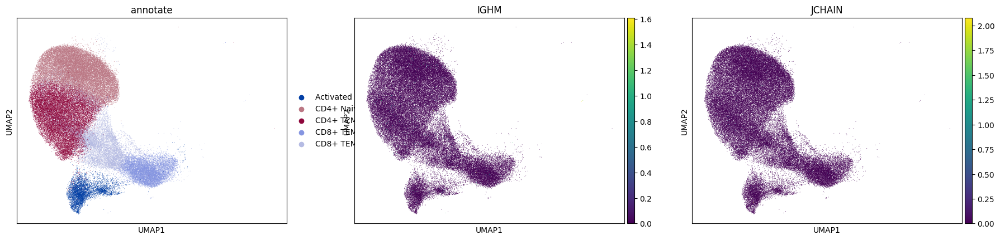

In [13]:

sc.pl.umap(adata , color=["annotate", "IGHM", "JCHAIN"])

Add a column name as sample_id

In [14]:
adata.obs["sample_id"] = adata.obs["sample"]
adata.var_names_make_unique()
adata

AnnData object with n_obs × n_vars = 74002 × 21606
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'mitoPercent', 'riboPercent', 'log10GenesPerUMI', 'cells', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'pANN_0.25_0.2_119', 'doublet_finder', 'pANN_0.25_0.06_24', 'pANN_0.25_0.04_39', 'pANN_0.25_0.02_12', 'pANN_0.25_0.03_91', 'pANN_0.25_0.07_280', 'pANN_0.25_0.22_1074', 'pANN_0.25_0.001_10', 'pANN_0.25_0.04_361', 'pANN_0.25_0.07_34', 'pANN_0.25_0.03_88', 'pANN_0.25_0.07_94', 'pANN_0.25_0.14_932', 'pANN_0.25_0.03_391', 'pANN_0.25_0.28_2189', 'pANN_0.25_0.1_1074', 'pANN_0.25_0.1_171', 'pANN_0.25_0.03_362', 'pANN_0.25_0.01_24', 'pANN_0.25_0.11_345', 'pANN_0.25_0.04_205', 'pANN_0.25_0.07_223', 'pANN_0.25_0.11_438', 'pANN_0.25_0.2_76', 'pANN_0.25_0.23_60', 'pANN_0.25_0.06_25', 'pANN_0.25_0.29_2023', 'pANN_0.25_0.27_1708', 'Disease', 'Sampletype', 'Patient', 'Center', 'samplename', 'harmony_clusters', 'annotate', 'sample_id'
    uns: 'annotate_colors'
    

Remove -1 from the barcode

In [15]:
import re

def process_barcode(barcode):
    # Remove the '-1' suffix and add 'R13_CSF_' prefix
    return re.sub(r'-1$', '', barcode)
# Apply the processing to all barcodes
adata.obs_names = adata.obs_names.map(process_barcode)

In [16]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,sample,mitoPercent,riboPercent,log10GenesPerUMI,cells,nCount_SCT,nFeature_SCT,...,pANN_0.25_0.29_2023,pANN_0.25_0.27_1708,Disease,Sampletype,Patient,Center,samplename,harmony_clusters,annotate,sample_id
control_CSF_8360_Munich_filtered_AAACCTGCACTTAAGC,SeuratProject,4098.0,1234,control_CSF_8360_Munich,2.098585,44.582723,0.855710,AAACCTGCACTTAAGC-1,3621.0,1221,...,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,1,CD4+ TCM,control_CSF_8360_Munich
control_CSF_8360_Munich_filtered_AAAGATGCATGTAAGA,SeuratProject,2487.0,977,control_CSF_8360_Munich,2.774427,32.891033,0.880501,AAAGATGCATGTAAGA-1,3103.0,972,...,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,4,CD8+ TEM,control_CSF_8360_Munich
control_CSF_8360_Munich_filtered_AAAGTAGCAAGGTGTG,SeuratProject,2997.0,1121,control_CSF_8360_Munich,1.034368,42.542543,0.877159,AAAGTAGCAAGGTGTG-1,3229.0,1111,...,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,0,CD4+ Naive T,control_CSF_8360_Munich
control_CSF_8360_Munich_filtered_AAATGCCAGTACGTTC,SeuratProject,3731.0,1109,control_CSF_8360_Munich,0.696864,51.541142,0.852486,AAATGCCAGTACGTTC-1,3511.0,1094,...,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,0,CD4+ Naive T,control_CSF_8360_Munich
control_CSF_8360_Munich_filtered_AAATGCCGTTCCAACA,SeuratProject,2973.0,1246,control_CSF_8360_Munich,1.950891,31.752439,0.891260,AAATGCCGTTCCAACA-1,3203.0,1231,...,NaN,NaN,control,CSF,8360,Munich,control_CSF_8360,2,"CD8+ TEM, MAIT, gDT",control_CSF_8360_Munich
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACAGACTCGC,SeuratProject,1323.0,655,GAD_PBMC_R3_Roterdam,2.116402,33.257748,0.902190,TTTGTCACAGACTCGC-1,2449.0,674,...,NaN,0.192354,GAD,PBMC,R3,Roterdam,GAD_PBMC_R3,1,CD4+ TCM,GAD_PBMC_R3_Roterdam
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACATGGTCTA,SeuratProject,4903.0,1379,GAD_PBMC_R3_Roterdam,3.161330,48.684479,0.850724,TTTGTCACATGGTCTA-1,3220.0,1344,...,NaN,0.146479,GAD,PBMC,R3,Roterdam,GAD_PBMC_R3,2,"CD8+ TEM, MAIT, gDT",GAD_PBMC_R3_Roterdam
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACATTAGGCT,SeuratProject,5173.0,1432,GAD_PBMC_R3_Roterdam,1.585154,47.438624,0.849801,TTTGTCACATTAGGCT-1,3249.0,1374,...,NaN,0.144064,GAD,PBMC,R3,Roterdam,GAD_PBMC_R3,1,CD4+ TCM,GAD_PBMC_R3_Roterdam
GAD_PBMC_R3_Roterdam_filtered_TTTGTCATCCAAGCCG,SeuratProject,3764.0,1118,GAD_PBMC_R3_Roterdam,2.284803,50.132837,0.852556,TTTGTCATCCAAGCCG-1,3056.0,1118,...,NaN,0.142857,GAD,PBMC,R3,Roterdam,GAD_PBMC_R3,0,CD4+ Naive T,GAD_PBMC_R3_Roterdam


There are also ddl.to_scirpy() and ddl.from_scirpy() for interoperability with Scirpy, as explored in a notebook in the advanced guide. Scirpy also offers its own conversion functions. 

Export vdj data as csv

In [10]:
vdj.data.to_csv("GAD_control_CSF_TCR_TSCM_filtered_contig_dandelion_table_17.11.24.tsv", sep="\t")

In [17]:
vdj.metadata

,locus_VDJ,locus_VJ,productive_VDJ,productive_VJ,v_call_VDJ,d_call_VDJ,j_call_VDJ,v_call_VJ,j_call_VJ,c_call_VDJ,...,d_call_abT_VDJ_main,j_call_abT_VDJ_main,v_call_abT_VJ_main,j_call_abT_VJ_main,isotype,isotype_status,locus_status,chain_status,rearrangement_status_VDJ,rearrangement_status_VJ
GAD_CSF_9910_Munich_filtered_AAACCTGAGGTGATAT,TRB,TRA|TRA,T,T|T,TRBV7-8,None,TRBJ1-5,TRAV29/DV5|TRAV29/DV5,TRAJ10|TRAJ40,TRBC1,...,None,TRBJ1-5,TRAV29/DV5,TRAJ10,None,None,TRB + Extra VJ,Extra pair,standard,standard
GAD_CSF_9910_Munich_filtered_AAACCTGCACTGTGTA,TRB,TRA,T,T,TRBV14,None,TRBJ1-6,TRAV9-2,TRAJ54,TRBC1,...,None,TRBJ1-6,TRAV9-2,TRAJ54,None,None,TRB + TRA,Single pair,standard,standard
GAD_CSF_9910_Munich_filtered_AAACCTGCAGACGCCT,TRB|TRB,TRA,T|T,T,TRBV10-1|TRBV12-4,None,TRBJ1-1|TRBJ1-5,TRAV38-1,TRAJ42,TRBC1|TRBC1,...,None,TRBJ1-1,TRAV38-1,TRAJ42,None|None,Multi,Extra VDJ + TRA,Extra pair,standard,standard
GAD_CSF_9910_Munich_filtered_AAACCTGCAGCCTATA,TRB,TRA,T,T,TRBV29-1,None,TRBJ1-1,TRAV8-2,TRAJ32,TRBC1,...,None,TRBJ1-1,TRAV8-2,TRAJ32,None,None,TRB + TRA,Single pair,standard,standard
GAD_CSF_9910_Munich_filtered_AAACGGGAGCTGCCCA,TRB,TRA,T,T,TRBV3-1,None,TRBJ2-7,TRAV36/DV7,TRAJ52,TRBC2,...,None,TRBJ2-7,TRAV36/DV7,TRAJ52,None,None,TRB + TRA,Single pair,standard,standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAD_PBMC_R3_Roterdam_filtered_TTCTCCTGTATCACCA,None,TRA,None,T,None,None,None,TRAV41,TRAJ45,None,...,None,None,TRAV41,TRAJ45,,,Orphan TRA,Orphan VJ,None,standard
GAD_PBMC_R3_Roterdam_filtered_TTGACTTAGTGGGTTG,None,TRA,None,T,None,None,None,TRAV27,TRAJ27,None,...,None,None,TRAV27,TRAJ27,,,Orphan TRA,Orphan VJ,None,standard
GAD_PBMC_R3_Roterdam_filtered_TTGACTTCAGATCGGA,None,TRA,None,T,None,None,None,TRAV19,TRAJ15,None,...,None,None,TRAV19,TRAJ15,,,Orphan TRA,Orphan VJ,None,standard
GAD_PBMC_R3_Roterdam_filtered_TTGCGTCTCAAGAAGT,None,TRA,None,T,None,None,None,TRAV12-1,TRAJ22,None,...,None,None,TRAV12-1,TRAJ22,,,Orphan TRA,Orphan VJ,None,standard


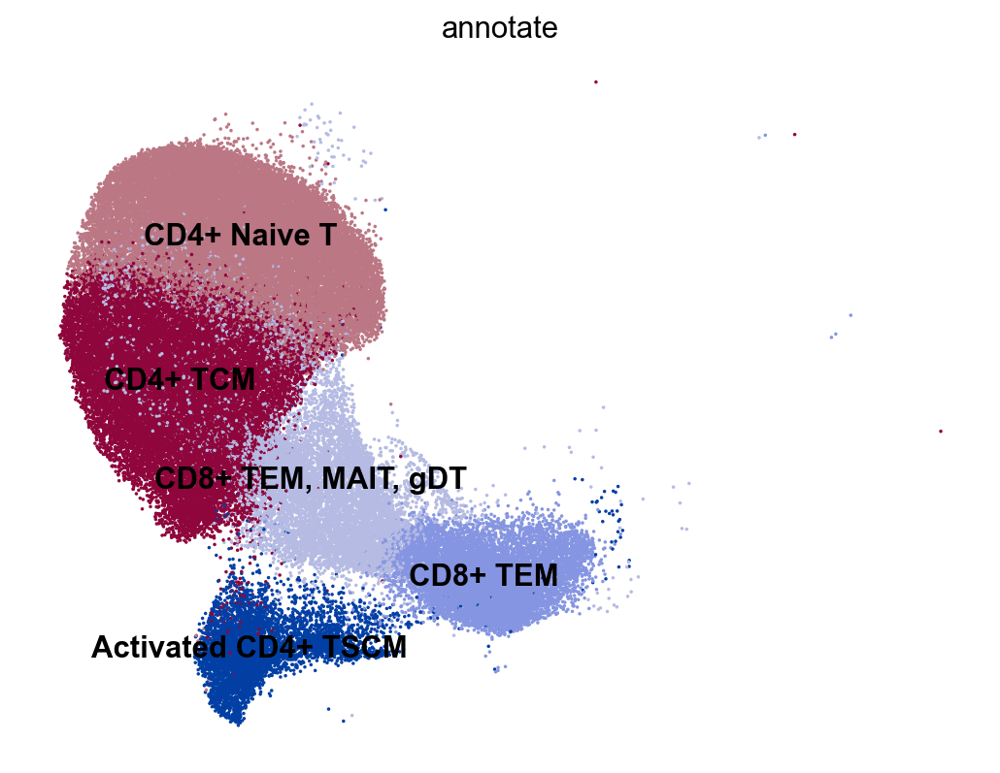

In [18]:
sc.set_figure_params(figsize=[8, 6])
sc.pl.umap(adata, color=["annotate"], legend_loc="on data", size=10, frameon=False, show=False)
#plt.savefig('GAD_control_final umap1.pdf', dpi=300, bbox_inches='tight')
plt.show()


 Link up a Scanpy object (adata) with a Dandelion one (vdj)

In [19]:
# The function will return both objects.
vdj, adata = ddl.pp.check_contigs(vdj, adata) # library_type="ig" #ig, tr-ab, tr-gd or None where None 

Preparing data: 35834it [00:15, 2378.03it/s]
Scanning for poor quality/ambiguous contigs: 100%|██████████| 19430/19430 [01:53<00:00, 171.42it/s]


Under the hood, the Dandelion object is essentially two data frames. .data holds the AIRR-compliant contig space table, while .metadata is an .obs equivalent that parses the contig information to a cell level and can be easily integrated with a Scanpy object.

In [20]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,sample,mitoPercent,riboPercent,log10GenesPerUMI,cells,nCount_SCT,nFeature_SCT,...,d_call_abT_VDJ_main,j_call_abT_VDJ_main,v_call_abT_VJ_main,j_call_abT_VJ_main,isotype,isotype_status,locus_status,chain_status,rearrangement_status_VDJ,rearrangement_status_VJ
control_CSF_8360_Munich_filtered_AAACCTGCACTTAAGC,SeuratProject,4098.0,1234,control_CSF_8360_Munich,2.098585,44.582723,0.855710,AAACCTGCACTTAAGC-1,3621.0,1221,...,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig
control_CSF_8360_Munich_filtered_AAAGATGCATGTAAGA,SeuratProject,2487.0,977,control_CSF_8360_Munich,2.774427,32.891033,0.880501,AAAGATGCATGTAAGA-1,3103.0,972,...,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig
control_CSF_8360_Munich_filtered_AAAGTAGCAAGGTGTG,SeuratProject,2997.0,1121,control_CSF_8360_Munich,1.034368,42.542543,0.877159,AAAGTAGCAAGGTGTG-1,3229.0,1111,...,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig
control_CSF_8360_Munich_filtered_AAATGCCAGTACGTTC,SeuratProject,3731.0,1109,control_CSF_8360_Munich,0.696864,51.541142,0.852486,AAATGCCAGTACGTTC-1,3511.0,1094,...,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig
control_CSF_8360_Munich_filtered_AAATGCCGTTCCAACA,SeuratProject,2973.0,1246,control_CSF_8360_Munich,1.950891,31.752439,0.891260,AAATGCCGTTCCAACA-1,3203.0,1231,...,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig,No_contig
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACAGACTCGC,SeuratProject,1323.0,655,GAD_PBMC_R3_Roterdam,2.116402,33.257748,0.902190,TTTGTCACAGACTCGC-1,2449.0,674,...,None,None,TRAV13-1,TRAJ42,,,Orphan TRA,Orphan VJ,None,standard
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACATGGTCTA,SeuratProject,4903.0,1379,GAD_PBMC_R3_Roterdam,3.161330,48.684479,0.850724,TTTGTCACATGGTCTA-1,3220.0,1344,...,TRBD1,TRBJ1-2,TRAV29/DV5,TRAJ39,None,None,TRB + Extra VJ,Extra pair,standard,standard
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACATTAGGCT,SeuratProject,5173.0,1432,GAD_PBMC_R3_Roterdam,1.585154,47.438624,0.849801,TTTGTCACATTAGGCT-1,3249.0,1374,...,None,TRBJ2-2,TRAV8-4,TRAJ28,None,None,TRB + TRA,Single pair,standard,standard
GAD_PBMC_R3_Roterdam_filtered_TTTGTCATCCAAGCCG,SeuratProject,3764.0,1118,GAD_PBMC_R3_Roterdam,2.284803,50.132837,0.852556,TTTGTCATCCAAGCCG-1,3056.0,1118,...,None,TRBJ2-3,None,None,None,None,Orphan TRB,Orphan VDJ,standard,None


In [21]:
vdj.metadata

,locus_VDJ,locus_VJ,productive_VDJ,productive_VJ,v_call_VDJ,d_call_VDJ,j_call_VDJ,v_call_VJ,j_call_VJ,c_call_VDJ,...,d_call_abT_VDJ_main,j_call_abT_VDJ_main,v_call_abT_VJ_main,j_call_abT_VJ_main,isotype,isotype_status,locus_status,chain_status,rearrangement_status_VDJ,rearrangement_status_VJ
GAD_CSF_9910_Munich_filtered_AAACCTGAGGTGATAT,TRB,TRA|TRA,T,T|T,TRBV7-8,None,TRBJ1-5,TRAV29/DV5|TRAV29/DV5,TRAJ10|TRAJ40,TRBC1,...,None,TRBJ1-5,TRAV29/DV5,TRAJ10,None,None,TRB + Extra VJ,Extra pair,standard,standard
GAD_CSF_9910_Munich_filtered_AAACCTGCACTGTGTA,TRB,TRA,T,T,TRBV14,None,TRBJ1-6,TRAV9-2,TRAJ54,TRBC1,...,None,TRBJ1-6,TRAV9-2,TRAJ54,None,None,TRB + TRA,Single pair,standard,standard
GAD_CSF_9910_Munich_filtered_AAACCTGCAGCCTATA,TRB,TRA,T,T,TRBV29-1,None,TRBJ1-1,TRAV8-2,TRAJ32,TRBC1,...,None,TRBJ1-1,TRAV8-2,TRAJ32,None,None,TRB + TRA,Single pair,standard,standard
GAD_CSF_9910_Munich_filtered_AAACGGGAGCTGCCCA,TRB,TRA,T,T,TRBV3-1,None,TRBJ2-7,TRAV36/DV7,TRAJ52,TRBC2,...,None,TRBJ2-7,TRAV36/DV7,TRAJ52,None,None,TRB + TRA,Single pair,standard,standard
GAD_CSF_9910_Munich_filtered_AAACGGGCAAGCTGGA,TRB,TRA,T,T,TRBV27,TRBD1,TRBJ1-6,TRAV8-4,TRAJ54,TRBC1,...,TRBD1,TRBJ1-6,TRAV8-4,TRAJ54,None,None,TRB + TRA,Single pair,standard,standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAD_PBMC_R3_Roterdam_filtered_TTCTACATCTTACCGC,None,TRA,None,T,None,None,None,TRAV13-2,TRAJ40,None,...,None,None,TRAV13-2,TRAJ40,,,Orphan TRA,Orphan VJ,None,standard
GAD_PBMC_R3_Roterdam_filtered_TTCTCCTGTATCACCA,None,TRA,None,T,None,None,None,TRAV41,TRAJ45,None,...,None,None,TRAV41,TRAJ45,,,Orphan TRA,Orphan VJ,None,standard
GAD_PBMC_R3_Roterdam_filtered_TTGACTTAGTGGGTTG,None,TRA,None,T,None,None,None,TRAV27,TRAJ27,None,...,None,None,TRAV27,TRAJ27,,,Orphan TRA,Orphan VJ,None,standard
GAD_PBMC_R3_Roterdam_filtered_TTGCGTCTCAAGAAGT,None,TRA,None,T,None,None,None,TRAV12-1,TRAJ22,None,...,None,None,TRAV12-1,TRAJ22,,,Orphan TRA,Orphan VJ,None,standard


Find clones

In [22]:
#ddl.tl.find_clones(vdj)
#for TCR
ddl.tl.find_clones(vdj, identity=1, key="junction")


Finding clones based on abT cell VJ chains : 100%|██████████| 1755/1755 [00:01<00:00, 1295.27it/s]
Refining clone assignment based on VJ chain pairing : 100%|██████████| 14140/14140 [00:00<00:00, 189664.30it/s]


(Optional):Here I want to remove the Orphan VJ cells (lacking BCR heavy chain i.e. VDJ information). Whether or not you want to do this is up to you. I’m doing this because I want to focus on the BCR heavy chain for now. You may elect to keep everything and that can be your starting point for further analysis.

In [23]:
vdj.metadata

,clone_id,clone_id_by_size,locus_VDJ,locus_VJ,productive_VDJ,productive_VJ,v_call_VDJ,d_call_VDJ,j_call_VDJ,v_call_VJ,...,d_call_abT_VDJ_main,j_call_abT_VDJ_main,v_call_abT_VJ_main,j_call_abT_VJ_main,isotype,isotype_status,locus_status,chain_status,rearrangement_status_VDJ,rearrangement_status_VJ
GAD_CSF_9910_Munich_filtered_AAACCTGAGGTGATAT,abT_VDJ_548_3_2_VJ_1744_3_1|abT_VDJ_548_3_2_VJ...,11447|2162,TRB,TRA|TRA,T,T|T,TRBV7-8,None,TRBJ1-5,TRAV29/DV5|TRAV29/DV5,...,None,TRBJ1-5,TRAV29/DV5,TRAJ10,None,None,TRB + Extra VJ,Extra pair,standard,standard
GAD_CSF_9910_Munich_filtered_AAACCTGCACTGTGTA,abT_VDJ_104_1_1_VJ_115_4_3,9393,TRB,TRA,T,T,TRBV14,None,TRBJ1-6,TRAV9-2,...,None,TRBJ1-6,TRAV9-2,TRAJ54,None,None,TRB + TRA,Single pair,standard,standard
GAD_CSF_9910_Munich_filtered_AAACCTGCAGCCTATA,abT_VDJ_160_5_1_VJ_1458_1_1,9394,TRB,TRA,T,T,TRBV29-1,None,TRBJ1-1,TRAV8-2,...,None,TRBJ1-1,TRAV8-2,TRAJ32,None,None,TRB + TRA,Single pair,standard,standard
GAD_CSF_9910_Munich_filtered_AAACGGGAGCTGCCCA,abT_VDJ_489_3_5_VJ_248_4_1,9395,TRB,TRA,T,T,TRBV3-1,None,TRBJ2-7,TRAV36/DV7,...,None,TRBJ2-7,TRAV36/DV7,TRAJ52,None,None,TRB + TRA,Single pair,standard,standard
GAD_CSF_9910_Munich_filtered_AAACGGGCAAGCTGGA,abT_VDJ_474_3_1_VJ_516_1_3,9396,TRB,TRA,T,T,TRBV27,TRBD1,TRBJ1-6,TRAV8-4,...,TRBD1,TRBJ1-6,TRAV8-4,TRAJ54,None,None,TRB + TRA,Single pair,standard,standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAD_PBMC_R3_Roterdam_filtered_TTTGTCAAGTGCGATG,abT_VDJ_232_3_7_VJ_320_2_4,4957,TRB,TRA,T,T,TRBV5-4,None,TRBJ1-1,TRAV5,...,None,TRBJ1-1,TRAV5,TRAJ12,None,None,TRB + TRA,Single pair,standard,standard
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACAGACTCGC,abT_VJ_301_3_1,4958,None,TRA,None,T,None,None,None,TRAV13-1,...,None,None,TRAV13-1,TRAJ42,,,Orphan TRA,Orphan VJ,None,standard
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACATGGTCTA,abT_VDJ_408_5_19_VJ_1223_2_3|abT_VDJ_408_5_19_...,4959|4960,TRB,TRA|TRA,T,T|T,TRBV6-5,TRBD1,TRBJ1-2,TRAV29/DV5|TRAV13-1,...,TRBD1,TRBJ1-2,TRAV29/DV5,TRAJ39,None,None,TRB + Extra VJ,Extra pair,standard,standard
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACATTAGGCT,abT_VDJ_275_3_3_VJ_1231_3_2,642,TRB,TRA,T,T,TRBV11-2,None,TRBJ2-2,TRAV8-4,...,None,TRBJ2-2,TRAV8-4,TRAJ28,None,None,TRB + TRA,Single pair,standard,standard


In [24]:
vdj.metadata["chain_status"]

GAD_CSF_9910_Munich_filtered_AAACCTGAGGTGATAT      Extra pair
GAD_CSF_9910_Munich_filtered_AAACCTGCACTGTGTA     Single pair
GAD_CSF_9910_Munich_filtered_AAACCTGCAGCCTATA     Single pair
GAD_CSF_9910_Munich_filtered_AAACGGGAGCTGCCCA     Single pair
GAD_CSF_9910_Munich_filtered_AAACGGGCAAGCTGGA     Single pair
                                                     ...     
GAD_PBMC_R3_Roterdam_filtered_TTTGTCAAGTGCGATG    Single pair
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACAGACTCGC      Orphan VJ
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACATGGTCTA     Extra pair
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACATTAGGCT    Single pair
GAD_PBMC_R3_Roterdam_filtered_TTTGTCATCCAAGCCG     Orphan VDJ
Name: chain_status, Length: 14140, dtype: object

In [25]:
##Recommended but also possible to filter later

# again, i'm removing the Orphan VJ cells (lacking BCR heavy chain i.e. VDJ information).
vdj = vdj[
    vdj.metadata.chain_status.isin(
        ["Single pair", "Extra pair", "Extra pair-exception", "Orphan VDJ", 'extra VDJ', 'extra VJ', 'two full chains']
    )
].copy()

Generate TCR network.

In [26]:
ddl.tl.generate_network(vdj)

Setting up data: 24671it [00:10, 2360.82it/s]
Linking edges : 100%|██████████| 12007/12007 [00:02<00:00, 5376.62it/s]


To benefit from faster layout computation, please install graph-tool: conda install -c conda-forge graph-tool
Computing network layout
Computing expanded network layout


Since we now know what our clonotype calls are, we can quantify clonal expansion. It’s possible to cap this at a desired maximum clonotype size.

In [23]:
ddl.tl.clone_size(vdj)
ddl.tl.clone_size(vdj, max_size=3)

In [24]:
ddl.tl.clone_size(vdj)
ddl.tl.clone_size(vdj, max_size=5)

In [25]:
ddl.tl.clone_size(vdj)
ddl.tl.clone_size(vdj, max_size=10)

In [26]:
vdj.metadata

,clone_id,clone_id_by_size,locus_VDJ,locus_VJ,productive_VDJ,productive_VJ,v_call_VDJ,d_call_VDJ,j_call_VDJ,v_call_VJ,...,isotype,isotype_status,locus_status,chain_status,rearrangement_status_VDJ,rearrangement_status_VJ,clone_id_size,clone_id_size_max_3,clone_id_size_max_5,clone_id_size_max_10
GAD_CSF_9910_Munich_filtered_AAACCTGAGGTGATAT,abT_VDJ_125_3_2_VJ_1179_3_1|abT_VDJ_125_3_2_VJ...,11447|2162,TRB,TRA|TRA,T,T|T,TRBV7-8,None,TRBJ1-5,TRAV29/DV5|TRAV29/DV5,...,None,None,TRB + Extra VJ,Extra pair,standard,standard,1.0,1,1,1
GAD_CSF_9910_Munich_filtered_AAACCTGCACTGTGTA,abT_VDJ_25_1_1_VJ_1370_4_1,9393,TRB,TRA,T,T,TRBV14,None,TRBJ1-6,TRAV9-2,...,None,None,TRB + TRA,Single pair,standard,standard,1.0,1,1,1
GAD_CSF_9910_Munich_filtered_AAACCTGCAGCCTATA,abT_VDJ_94_5_4_VJ_1668_1_1,9394,TRB,TRA,T,T,TRBV29-1,None,TRBJ1-1,TRAV8-2,...,None,None,TRB + TRA,Single pair,standard,standard,1.0,1,1,1
GAD_CSF_9910_Munich_filtered_AAACGGGAGCTGCCCA,abT_VDJ_151_3_8_VJ_675_4_2,9395,TRB,TRA,T,T,TRBV3-1,None,TRBJ2-7,TRAV36/DV7,...,None,None,TRB + TRA,Single pair,standard,standard,1.0,1,1,1
GAD_CSF_9910_Munich_filtered_AAACGGGCAAGCTGGA,abT_VDJ_193_3_1_VJ_387_1_7,9396,TRB,TRA,T,T,TRBV27,TRBD1,TRBJ1-6,TRAV8-4,...,None,None,TRB + TRA,Single pair,standard,standard,1.0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAD_PBMC_R3_Roterdam_filtered_TTTGGTTTCTCTAAGG,abT_VDJ_361_5_4_VJ_132_6_1|abT_VDJ_361_5_4_VJ_...,4955|4956,TRB,TRA|TRA,T,T|T,TRBV30,None,TRBJ2-1,TRAV38-2/DV8|TRAV23/DV6,...,None,None,TRB + Extra VJ,Extra pair,standard,standard,1.0,1,1,1
GAD_PBMC_R3_Roterdam_filtered_TTTGTCAAGTGCGATG,abT_VDJ_288_3_7_VJ_1414_2_3,4957,TRB,TRA,T,T,TRBV5-4,None,TRBJ1-1,TRAV5,...,None,None,TRB + TRA,Single pair,standard,standard,1.0,1,1,1
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACATGGTCTA,abT_VDJ_143_5_1_VJ_1400_1_1|abT_VDJ_143_5_1_VJ...,4959|4960,TRB,TRA|TRA,T,T|T,TRBV6-5,TRBD1,TRBJ1-2,TRAV29/DV5|TRAV13-1,...,None,None,TRB + Extra VJ,Extra pair,standard,standard,1.0,1,1,1
GAD_PBMC_R3_Roterdam_filtered_TTTGTCACATTAGGCT,abT_VDJ_287_3_6_VJ_790_3_3,642,TRB,TRA,T,T,TRBV11-2,None,TRBJ2-2,TRAV8-4,...,None,None,TRB + TRA,Single pair,standard,standard,2.0,2,2,2


To proceed, we first need to initialise the AnnData object with our network. This is done by using the tool function tl.transfer.

In [27]:
ddl.tl.transfer(adata, vdj)

In [29]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,sample,mitoPercent,riboPercent,log10GenesPerUMI,cells,nCount_SCT,nFeature_SCT,...,locus_status,chain_status,rearrangement_status_VDJ,rearrangement_status_VJ,clone_id,clone_id_by_size,clone_id_size,clone_id_size_max_3,clone_id_size_max_5,clone_id_size_max_10
control_CSF_8360_Munich_filtered_AAGGAGCAGCCACGTC,SeuratProject,536.0,385,control_CSF_8360_Munich,2.985075,2.611940,0.947345,AAGGAGCAGCCACGTC-1,2319.0,630,...,Orphan TRB,Orphan VDJ,standard,None,abT_VDJ_168_5_1,534,1.0,1,1,1
control_CSF_8360_Munich_filtered_ACACTGACAATCAGAA,SeuratProject,804.0,514,control_CSF_8360_Munich,5.970149,2.860697,0.933124,ACACTGACAATCAGAA-1,2443.0,711,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
control_CSF_8360_Munich_filtered_ACTGAGTCATCGGACC,SeuratProject,875.0,630,control_CSF_8360_Munich,4.685714,7.771429,0.951507,ACTGAGTCATCGGACC-1,2394.0,768,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
control_CSF_8360_Munich_filtered_AGTTGGTAGATGTAAC,SeuratProject,2661.0,1201,control_CSF_8360_Munich,2.517850,30.665163,0.899125,AGTTGGTAGATGTAAC-1,3068.0,1176,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_346_2_1_VJ_1009_1_1,535,1.0,1,1,1
control_CSF_8360_Munich_filtered_CACCACTAGGAATCGC,SeuratProject,1536.0,1002,control_CSF_8360_Munich,4.817708,4.622396,0.941776,CACCACTAGGAATCGC-1,2914.0,1067,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAD_PBMC_R3_Roterdam_filtered_TTAGGCATCGTCCAGG,SeuratProject,4181.0,1531,GAD_PBMC_R3_Roterdam,1.913418,42.740971,0.879516,TTAGGCATCGTCCAGG-1,3380.0,1526,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
GAD_PBMC_R3_Roterdam_filtered_TTCTACAAGATGTTAG,SeuratProject,2878.0,1186,GAD_PBMC_R3_Roterdam,3.092425,36.309937,0.888697,TTCTACAAGATGTTAG-1,2831.0,1183,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
GAD_PBMC_R3_Roterdam_filtered_TTGACTTAGAAACGCC,SeuratProject,2574.0,1405,GAD_PBMC_R3_Roterdam,1.748252,21.173271,0.922908,TTGACTTAGAAACGCC-1,2630.0,1404,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
GAD_PBMC_R3_Roterdam_filtered_TTGCCGTTCGCACTCT,SeuratProject,1529.0,694,GAD_PBMC_R3_Roterdam,4.643558,40.483976,0.892273,TTGCCGTTCGCACTCT-1,2344.0,699,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN


To show only expanded clones, specify expanded_only=True

In [37]:
adata2 = adata.copy()
ddl.tl.transfer(adata2, vdj, expanded_only=True)
adata2



AnnData object with n_obs × n_vars = 74002 × 21606
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'mitoPercent', 'riboPercent', 'log10GenesPerUMI', 'cells', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'pANN_0.25_0.2_119', 'doublet_finder', 'pANN_0.25_0.06_24', 'pANN_0.25_0.04_39', 'pANN_0.25_0.02_12', 'pANN_0.25_0.03_91', 'pANN_0.25_0.07_280', 'pANN_0.25_0.22_1074', 'pANN_0.25_0.001_10', 'pANN_0.25_0.04_361', 'pANN_0.25_0.07_34', 'pANN_0.25_0.03_88', 'pANN_0.25_0.07_94', 'pANN_0.25_0.14_932', 'pANN_0.25_0.03_391', 'pANN_0.25_0.28_2189', 'pANN_0.25_0.1_1074', 'pANN_0.25_0.1_171', 'pANN_0.25_0.03_362', 'pANN_0.25_0.01_24', 'pANN_0.25_0.11_345', 'pANN_0.25_0.04_205', 'pANN_0.25_0.07_223', 'pANN_0.25_0.11_438', 'pANN_0.25_0.2_76', 'pANN_0.25_0.23_60', 'pANN_0.25_0.06_25', 'pANN_0.25_0.29_2023', 'pANN_0.25_0.27_1708', 'Disease', 'Sampletype', 'Patient', 'Center', 'samplename', 'harmony_clusters', 'annotate', 'sample_id', 'has_contig', 'locus_VDJ', 'lo

Export the object

In [29]:
adata.write("seurat_object_combined_singlets_integrated_GAD_CSF_PBMC_Tcell_TCR_transfered_ADATA_dandelion.h5ad")
vdj.write("seurat_object_combined_singlets_integrated_GAD_CSF_PBMC_Tcell_TCR_transfered_VDJ_dandelion.h5ddl")


Load anndata object if needed

In [4]:
adata = sc.read("GAD_CSF_PBMC_Tcell_TCR_transfered_ADATA_dandelion_17.11.2024.h5ad")
adata

Only considering the two last: ['.2024', '.h5ad'].
Only considering the two last: ['.2024', '.h5ad'].


AnnData object with n_obs × n_vars = 74002 × 21606
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'mitoPercent', 'riboPercent', 'log10GenesPerUMI', 'cells', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'pANN_0.25_0.2_119', 'doublet_finder', 'pANN_0.25_0.06_24', 'pANN_0.25_0.04_39', 'pANN_0.25_0.02_12', 'pANN_0.25_0.03_91', 'pANN_0.25_0.07_280', 'pANN_0.25_0.22_1074', 'pANN_0.25_0.001_10', 'pANN_0.25_0.04_361', 'pANN_0.25_0.07_34', 'pANN_0.25_0.03_88', 'pANN_0.25_0.07_94', 'pANN_0.25_0.14_932', 'pANN_0.25_0.03_391', 'pANN_0.25_0.28_2189', 'pANN_0.25_0.1_1074', 'pANN_0.25_0.1_171', 'pANN_0.25_0.03_362', 'pANN_0.25_0.01_24', 'pANN_0.25_0.11_345', 'pANN_0.25_0.04_205', 'pANN_0.25_0.07_223', 'pANN_0.25_0.11_438', 'pANN_0.25_0.2_76', 'pANN_0.25_0.23_60', 'pANN_0.25_0.06_25', 'pANN_0.25_0.29_2023', 'pANN_0.25_0.27_1708', 'Disease', 'Sampletype', 'Patient', 'Center', 'samplename', 'harmony_clusters', 'annotate', 'sample_id', 'has_contig', 'locus_VDJ', 'lo

Load vdj object if needed

In [5]:
vdj = ddl.read_h5ddl("GAD_CSF_PBMC_Tcell_TCR_transfered_VDJ_dandelion_17.11.2024.h5ddl")
vdj

Dandelion class object with n_obs = 13423 and n_contigs = 24935
    data: 'sequence_id', 'sequence', 'rev_comp', 'productive', 'v_call', 'd_call', 'j_call', 'sequence_alignment', 'germline_alignment', 'junction', 'junction_aa', 'v_cigar', 'd_cigar', 'j_cigar', 'stop_codon', 'vj_in_frame', 'locus', 'c_call', 'junction_length', 'np1_length', 'np2_length', 'v_sequence_start', 'v_sequence_end', 'v_germline_start', 'v_germline_end', 'd_sequence_start', 'd_sequence_end', 'd_germline_start', 'd_germline_end', 'j_sequence_start', 'j_sequence_end', 'j_germline_start', 'j_germline_end', 'v_score', 'v_identity', 'v_support', 'd_score', 'd_identity', 'd_support', 'j_score', 'j_identity', 'j_support', 'fwr1', 'fwr2', 'fwr3', 'fwr4', 'cdr1', 'cdr2', 'cdr3', 'cell_id', 'consensus_count', 'umi_count', 'v_call_10x', 'd_call_10x', 'j_call_10x', 'junction_10x', 'junction_10x_aa', 'j_support_igblastn', 'j_score_igblastn', 'j_call_igblastn', 'j_call_blastn', 'j_identity_blastn', 'j_alignment_length_blastn'

In [93]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,sample,mitoPercent,riboPercent,log10GenesPerUMI,cells,nCount_SCT,nFeature_SCT,...,locus_status,chain_status,rearrangement_status_VDJ,rearrangement_status_VJ,clone_id,clone_id_by_size,clone_id_size,clone_id_size_max_3,clone_id_size_max_5,clone_id_size_max_10
control_CSF_8360_Munich_filtered_AAGGAGCAGCCACGTC,SeuratProject,536.0,385,control_CSF_8360_Munich,2.985075,2.611940,0.947345,AAGGAGCAGCCACGTC-1,2319.0,630,...,Orphan TRB,Orphan VDJ,standard,None,abT_VDJ_496_10_1,22670,1.0,1,1,1
control_CSF_8360_Munich_filtered_ACACTGACAATCAGAA,SeuratProject,804.0,514,control_CSF_8360_Munich,5.970149,2.860697,0.933124,ACACTGACAATCAGAA-1,2443.0,711,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
control_CSF_8360_Munich_filtered_ACTGAGTCATCGGACC,SeuratProject,875.0,630,control_CSF_8360_Munich,4.685714,7.771429,0.951507,ACTGAGTCATCGGACC-1,2394.0,768,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
control_CSF_8360_Munich_filtered_AGTTGGTAGATGTAAC,SeuratProject,2661.0,1201,control_CSF_8360_Munich,2.517850,30.665163,0.899125,AGTTGGTAGATGTAAC-1,3068.0,1176,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_431_3_1_VJ_428_2_4,22660,1.0,1,1,1
control_CSF_8360_Munich_filtered_CACCACTAGGAATCGC,SeuratProject,1536.0,1002,control_CSF_8360_Munich,4.817708,4.622396,0.941776,CACCACTAGGAATCGC-1,2914.0,1067,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAD_PBMC_R3_Roterdam_filtered_TTAGGCATCGTCCAGG,SeuratProject,4181.0,1531,GAD_PBMC_R3_Roterdam,1.913418,42.740971,0.879516,TTAGGCATCGTCCAGG-1,3380.0,1526,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
GAD_PBMC_R3_Roterdam_filtered_TTCTACAAGATGTTAG,SeuratProject,2878.0,1186,GAD_PBMC_R3_Roterdam,3.092425,36.309937,0.888697,TTCTACAAGATGTTAG-1,2831.0,1183,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
GAD_PBMC_R3_Roterdam_filtered_TTGACTTAGAAACGCC,SeuratProject,2574.0,1405,GAD_PBMC_R3_Roterdam,1.748252,21.173271,0.922908,TTGACTTAGAAACGCC-1,2630.0,1404,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
GAD_PBMC_R3_Roterdam_filtered_TTGCCGTTCGCACTCT,SeuratProject,1529.0,694,GAD_PBMC_R3_Roterdam,4.643558,40.483976,0.892273,TTGCCGTTCGCACTCT-1,2344.0,699,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN


In [34]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,sample,mitoPercent,riboPercent,log10GenesPerUMI,cells,nCount_SCT,nFeature_SCT,...,locus_status,chain_status,rearrangement_status_VDJ,rearrangement_status_VJ,clone_id,clone_id_by_size,clone_id_size,clone_id_size_max_3,clone_id_size_max_5,clone_id_size_max_10
control_CSF_8360_Munich_filtered_AAGGAGCAGCCACGTC,SeuratProject,536.0,385,control_CSF_8360_Munich,2.985075,2.611940,0.947345,AAGGAGCAGCCACGTC-1,2319.0,630,...,Orphan TRB,Orphan VDJ,standard,None,abT_VDJ_159_5_1,534,1.0,1,1,1
control_CSF_8360_Munich_filtered_ACACTGACAATCAGAA,SeuratProject,804.0,514,control_CSF_8360_Munich,5.970149,2.860697,0.933124,ACACTGACAATCAGAA-1,2443.0,711,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
control_CSF_8360_Munich_filtered_ACTGAGTCATCGGACC,SeuratProject,875.0,630,control_CSF_8360_Munich,4.685714,7.771429,0.951507,ACTGAGTCATCGGACC-1,2394.0,768,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
control_CSF_8360_Munich_filtered_AGTTGGTAGATGTAAC,SeuratProject,2661.0,1201,control_CSF_8360_Munich,2.517850,30.665163,0.899125,AGTTGGTAGATGTAAC-1,3068.0,1176,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_294_2_1_VJ_12_1_2,535,1.0,1,1,1
control_CSF_8360_Munich_filtered_CACCACTAGGAATCGC,SeuratProject,1536.0,1002,control_CSF_8360_Munich,4.817708,4.622396,0.941776,CACCACTAGGAATCGC-1,2914.0,1067,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAD_PBMC_R3_Roterdam_filtered_TTAGGCATCGTCCAGG,SeuratProject,4181.0,1531,GAD_PBMC_R3_Roterdam,1.913418,42.740971,0.879516,TTAGGCATCGTCCAGG-1,3380.0,1526,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
GAD_PBMC_R3_Roterdam_filtered_TTCTACAAGATGTTAG,SeuratProject,2878.0,1186,GAD_PBMC_R3_Roterdam,3.092425,36.309937,0.888697,TTCTACAAGATGTTAG-1,2831.0,1183,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
GAD_PBMC_R3_Roterdam_filtered_TTGACTTAGAAACGCC,SeuratProject,2574.0,1405,GAD_PBMC_R3_Roterdam,1.748252,21.173271,0.922908,TTGACTTAGAAACGCC-1,2630.0,1404,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN
GAD_PBMC_R3_Roterdam_filtered_TTGCCGTTCGCACTCT,SeuratProject,1529.0,694,GAD_PBMC_R3_Roterdam,4.643558,40.483976,0.892273,TTGCCGTTCGCACTCT-1,2344.0,699,...,No_contig,No_contig,No_contig,No_contig,No_contig,NaN,NaN,NaN,NaN,NaN


In [5]:
adata.obs["chain_status"]

control_CSF_8360_Munich_filtered_AAGGAGCAGCCACGTC     Orphan VDJ
control_CSF_8360_Munich_filtered_ACACTGACAATCAGAA      No_contig
control_CSF_8360_Munich_filtered_ACTGAGTCATCGGACC      No_contig
control_CSF_8360_Munich_filtered_AGTTGGTAGATGTAAC    Single pair
control_CSF_8360_Munich_filtered_CACCACTAGGAATCGC      No_contig
                                                        ...     
GAD_PBMC_R3_Roterdam_filtered_TTAGGCATCGTCCAGG         No_contig
GAD_PBMC_R3_Roterdam_filtered_TTCTACAAGATGTTAG         No_contig
GAD_PBMC_R3_Roterdam_filtered_TTGACTTAGAAACGCC         No_contig
GAD_PBMC_R3_Roterdam_filtered_TTGCCGTTCGCACTCT         No_contig
GAD_PBMC_R3_Roterdam_filtered_TTGCGTCAGTTACGGG         No_contig
Name: chain_status, Length: 5539, dtype: category
Categories (5, object): ['Extra pair', 'No_contig', 'Orphan VDJ', 'Orphan VJ', 'Single pair']

First check chain _status and chain_locus of non filtered adata

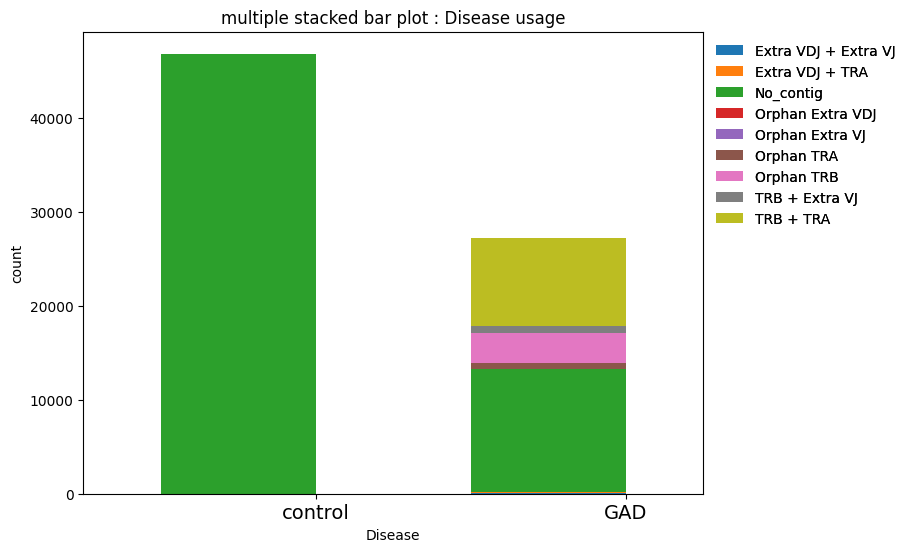

In [6]:

ddl.pl.stackedbarplot(
    adata,
    color="Disease",
    groupby="locus_status",
    xtick_rotation=0,
    figsize=(8, 6),
    xtick_fontsize=14, 

)

plt.legend(bbox_to_anchor=(1, 1), loc="upper left",frameon=False)

In [10]:
adata

AnnData object with n_obs × n_vars = 5539 × 21606
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'mitoPercent', 'riboPercent', 'log10GenesPerUMI', 'cells', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'pANN_0.25_0.2_119', 'doublet_finder', 'pANN_0.25_0.06_24', 'pANN_0.25_0.04_39', 'pANN_0.25_0.02_12', 'pANN_0.25_0.03_91', 'pANN_0.25_0.07_280', 'pANN_0.25_0.22_1074', 'pANN_0.25_0.001_10', 'pANN_0.25_0.04_361', 'pANN_0.25_0.07_34', 'pANN_0.25_0.03_88', 'pANN_0.25_0.07_94', 'pANN_0.25_0.14_932', 'pANN_0.25_0.03_391', 'pANN_0.25_0.28_2189', 'pANN_0.25_0.1_1074', 'pANN_0.25_0.1_171', 'pANN_0.25_0.03_362', 'pANN_0.25_0.01_24', 'pANN_0.25_0.11_345', 'pANN_0.25_0.04_205', 'pANN_0.25_0.07_223', 'pANN_0.25_0.11_438', 'pANN_0.25_0.2_76', 'pANN_0.25_0.23_60', 'pANN_0.25_0.06_25', 'pANN_0.25_0.29_2023', 'pANN_0.25_0.27_1708', 'Disease', 'Sampletype', 'Patient', 'Center', 'samplename', 'harmony_clusters', 'annotate', 'sample_id', 'has_contig', 'locus_VDJ', 'loc

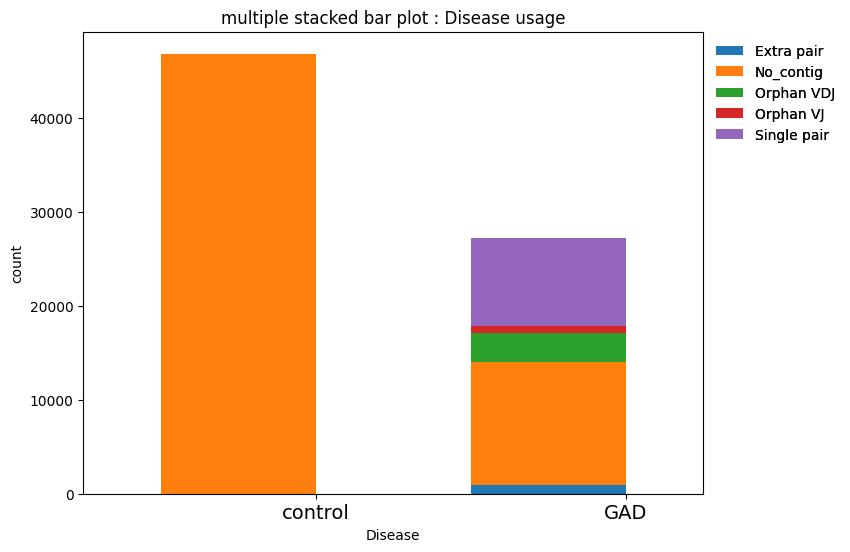

In [7]:

ddl.pl.stackedbarplot(
    adata,
    color="Disease",
    groupby="chain_status",
    xtick_rotation=0,
    figsize=(8, 6),
    xtick_fontsize=14, 

)

plt.legend(bbox_to_anchor=(1, 1), loc="upper left",frameon=False)

In [8]:
import numpy as np

adata_filtered = adata[adata.obs['chain_status'].isin(['Single pair', 'Extra pair'])].copy()

adata_filtered = adata_filtered[adata_filtered.obs['locus_status'].isin(['TRB + TRA',  'TRB + Extra VJ'])].copy() 





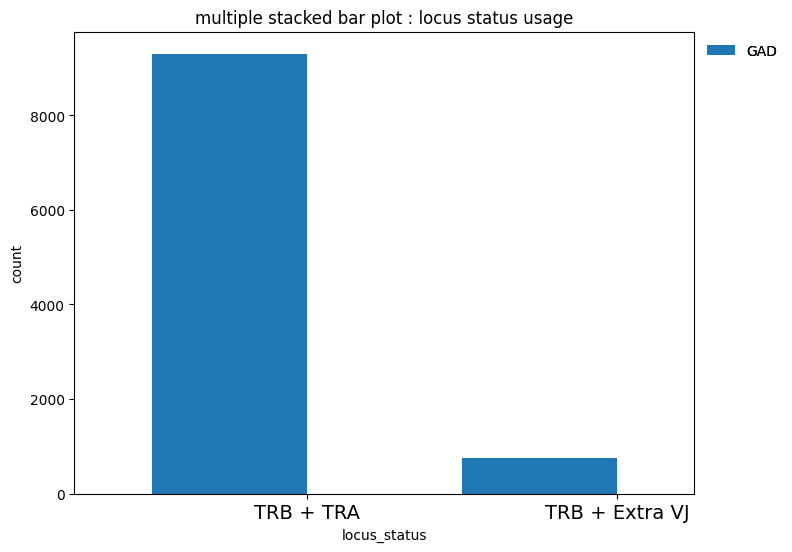

In [9]:

ddl.pl.stackedbarplot(
    adata_filtered,
    color="locus_status",
    groupby="Disease",
    xtick_rotation=0,
    figsize=(8, 6),
    xtick_fontsize=14, 

)

plt.legend(bbox_to_anchor=(1, 1), loc="upper left",frameon=False)

Check again

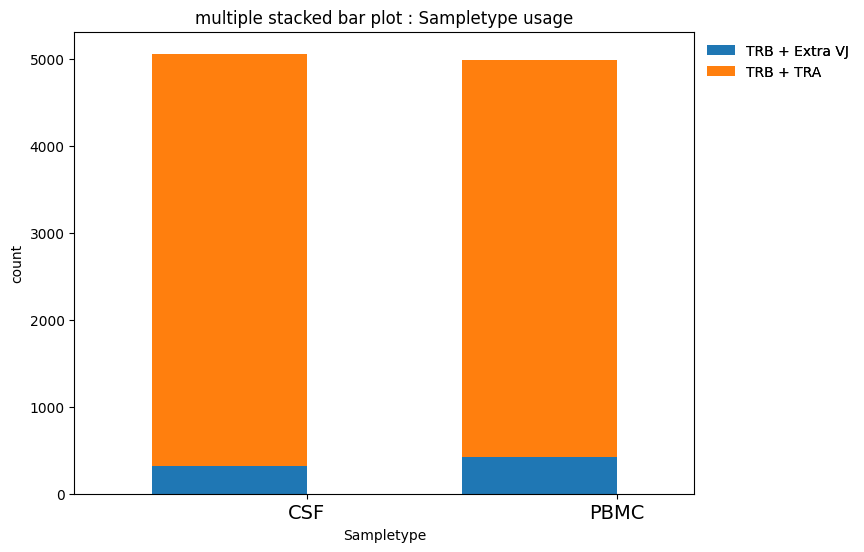

In [10]:

ddl.pl.stackedbarplot(
    adata_filtered,
    color="Sampletype",
    groupby="locus_status",
    xtick_rotation=0,
    figsize=(8, 6),
    xtick_fontsize=14, 

)

plt.legend(bbox_to_anchor=(1, 1), loc="upper left",frameon=False)

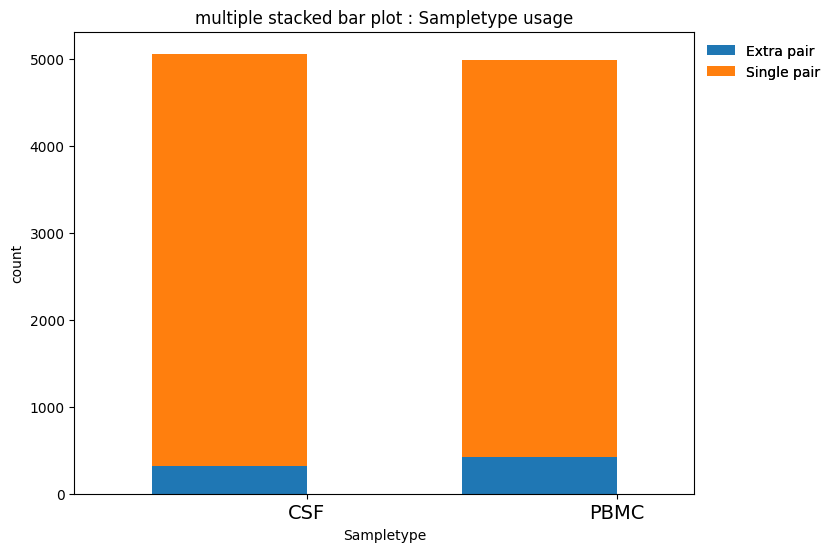

In [11]:

ddl.pl.stackedbarplot(
    adata_filtered,
    color="Sampletype",
    groupby="chain_status",
    xtick_rotation=0,
    figsize=(8, 6),
    xtick_fontsize=14, 

)

plt.legend(bbox_to_anchor=(1, 1), loc="upper left",frameon=False)

In [15]:
adata_filtered.obs

,orig.ident,nCount_RNA,nFeature_RNA,sample,mitoPercent,riboPercent,log10GenesPerUMI,cells,nCount_SCT,nFeature_SCT,...,locus_status,chain_status,rearrangement_status_VDJ,rearrangement_status_VJ,clone_id,clone_id_by_size,clone_id_size,clone_id_size_max_3,clone_id_size_max_5,clone_id_size_max_10
control_CSF_8360_Munich_filtered_AGTTGGTAGATGTAAC,SeuratProject,2661.0,1201,control_CSF_8360_Munich,2.517850,30.665163,0.899125,AGTTGGTAGATGTAAC-1,3068.0,1176,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_294_2_1_VJ_12_1_2,535,1.0,1,1,1
control_CSF_8360_Munich_filtered_CCGTGGATCTAACCGA,SeuratProject,664.0,413,control_CSF_8360_Munich,5.572289,3.012048,0.926929,CCGTGGATCTAACCGA-1,2474.0,625,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_238_1_2_VJ_904_1_2,536,1.0,1,1,1
control_CSF_8360_Munich_filtered_CCGTTCAAGGGCACTA,SeuratProject,1349.0,849,control_CSF_8360_Munich,6.375093,5.337287,0.935750,CCGTTCAAGGGCACTA-1,2792.0,925,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_277_5_1_VJ_438_4_4,565,1.0,1,1,1
control_CSF_8360_Munich_filtered_CTACATTAGTATGACA,SeuratProject,1213.0,706,control_CSF_8360_Munich,0.247321,3.709810,0.923779,CTACATTAGTATGACA-1,2803.0,821,...,TRB + Extra VJ,Extra pair,standard,standard,abT_VDJ_424_8_1_VJ_1005_2_2|abT_VDJ_424_8_1_VJ...,563|564,1.0,1,1,1
control_CSF_8360_Munich_filtered_CTCACACAGTTAGGTA,SeuratProject,3409.0,1423,control_CSF_8360_Munich,0.176005,31.886184,0.892595,CTCACACAGTTAGGTA-1,3389.0,1406,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_136_5_1_VJ_88_2_1,562,1.0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAD_CSF_R3_Roterdam_filtered_TTAGTTCAGGCGACAT,SeuratProject,1423.0,767,GAD_CSF_R3_Roterdam,2.670415,34.785664,0.914877,TTAGTTCAGGCGACAT-1,1904.0,745,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_86_1_1_VJ_126_1_1,48,2.0,2,2,2
GAD_CSF_R3_Roterdam_filtered_TTCGGTCGTGATAAGT,SeuratProject,1393.0,740,GAD_CSF_R3_Roterdam,1.292175,37.975592,0.912620,TTCGGTCGTGATAAGT-1,1902.0,727,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_226_3_7_VJ_43_2_1,507,1.0,1,1,1
GAD_CSF_R3_Roterdam_filtered_TTCTCAACAGACAGGT,SeuratProject,3951.0,1403,GAD_CSF_R3_Roterdam,1.847634,42.698051,0.874983,TTCTCAACAGACAGGT-1,2680.0,1355,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_11_1_1_VJ_426_1_1,506,1.0,1,1,1
GAD_CSF_R3_Roterdam_filtered_TTTCCTCCACCAACCG,SeuratProject,1339.0,668,GAD_CSF_R3_Roterdam,2.539208,38.610904,0.903414,TTTCCTCCACCAACCG-1,1913.0,656,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_226_4_2_VJ_457_1_1,53,2.0,2,2,2


For only expanded clones

In [38]:
import numpy as np

adata_filtered2 = adata2[adata2.obs['chain_status'].isin(['Single pair', 'Extra pair'])].copy()


adata_filtered2 = adata_filtered2[adata_filtered2.obs['locus_status'].isin(['TRB + TRA',  'TRB + Extra VJ'])].copy() 




In [80]:
adata_filtered2.obs["locus_status"]

control_CSF_8360_Munich_filtered_AGTTGGTAGATGTAAC         TRB + TRA
control_CSF_8360_Munich_filtered_CCGTGGATCTAACCGA         TRB + TRA
control_CSF_8360_Munich_filtered_CCGTTCAAGGGCACTA         TRB + TRA
control_CSF_8360_Munich_filtered_CTACATTAGTATGACA    TRB + Extra VJ
control_CSF_8360_Munich_filtered_CTCACACAGTTAGGTA         TRB + TRA
                                                          ...      
GAD_CSF_R3_Roterdam_filtered_TTAGTTCAGGCGACAT             TRB + TRA
GAD_CSF_R3_Roterdam_filtered_TTCGGTCGTGATAAGT             TRB + TRA
GAD_CSF_R3_Roterdam_filtered_TTCTCAACAGACAGGT             TRB + TRA
GAD_CSF_R3_Roterdam_filtered_TTTCCTCCACCAACCG             TRB + TRA
GAD_CSF_R3_Roterdam_filtered_TTTGTCATCTACTCAT             TRB + TRA
Name: locus_status, Length: 1780, dtype: category
Categories (4, object): ['Extra VDJ + Extra VJ', 'Extra VDJ + TRA', 'TRB + Extra VJ', 'TRB + TRA']

In [81]:
adata_filtered2.obs

,orig.ident,nCount_RNA,nFeature_RNA,sample,mitoPercent,riboPercent,log10GenesPerUMI,cells,nCount_SCT,nFeature_SCT,...,locus_status,chain_status,rearrangement_status_VDJ,rearrangement_status_VJ,clone_id,clone_id_by_size,clone_id_size,clone_id_size_max_3,clone_id_size_max_5,clone_id_size_max_10
control_CSF_8360_Munich_filtered_AGTTGGTAGATGTAAC,SeuratProject,2661.0,1201,control_CSF_8360_Munich,2.517850,30.665163,0.899125,AGTTGGTAGATGTAAC-1,3068.0,1176,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_294_2_1_VJ_12_1_2,535,1.0,1,1,1
control_CSF_8360_Munich_filtered_CCGTGGATCTAACCGA,SeuratProject,664.0,413,control_CSF_8360_Munich,5.572289,3.012048,0.926929,CCGTGGATCTAACCGA-1,2474.0,625,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_238_1_2_VJ_904_1_2,536,1.0,1,1,1
control_CSF_8360_Munich_filtered_CCGTTCAAGGGCACTA,SeuratProject,1349.0,849,control_CSF_8360_Munich,6.375093,5.337287,0.935750,CCGTTCAAGGGCACTA-1,2792.0,925,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_277_5_1_VJ_438_4_4,565,1.0,1,1,1
control_CSF_8360_Munich_filtered_CTACATTAGTATGACA,SeuratProject,1213.0,706,control_CSF_8360_Munich,0.247321,3.709810,0.923779,CTACATTAGTATGACA-1,2803.0,821,...,TRB + Extra VJ,Extra pair,standard,standard,abT_VDJ_424_8_1_VJ_1005_2_2|abT_VDJ_424_8_1_VJ...,563|564,1.0,1,1,1
control_CSF_8360_Munich_filtered_CTCACACAGTTAGGTA,SeuratProject,3409.0,1423,control_CSF_8360_Munich,0.176005,31.886184,0.892595,CTCACACAGTTAGGTA-1,3389.0,1406,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_136_5_1_VJ_88_2_1,562,1.0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAD_CSF_R3_Roterdam_filtered_TTAGTTCAGGCGACAT,SeuratProject,1423.0,767,GAD_CSF_R3_Roterdam,2.670415,34.785664,0.914877,TTAGTTCAGGCGACAT-1,1904.0,745,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_86_1_1_VJ_126_1_1,48,2.0,2,2,2
GAD_CSF_R3_Roterdam_filtered_TTCGGTCGTGATAAGT,SeuratProject,1393.0,740,GAD_CSF_R3_Roterdam,1.292175,37.975592,0.912620,TTCGGTCGTGATAAGT-1,1902.0,727,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_226_3_7_VJ_43_2_1,507,1.0,1,1,1
GAD_CSF_R3_Roterdam_filtered_TTCTCAACAGACAGGT,SeuratProject,3951.0,1403,GAD_CSF_R3_Roterdam,1.847634,42.698051,0.874983,TTCTCAACAGACAGGT-1,2680.0,1355,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_11_1_1_VJ_426_1_1,506,1.0,1,1,1
GAD_CSF_R3_Roterdam_filtered_TTTCCTCCACCAACCG,SeuratProject,1339.0,668,GAD_CSF_R3_Roterdam,2.539208,38.610904,0.903414,TTTCCTCCACCAACCG-1,1913.0,656,...,TRB + TRA,Single pair,standard,standard,abT_VDJ_226_4_2_VJ_457_1_1,53,2.0,2,2,2


Expanded vs nonexpanded

GAD_CSF and PBMC

In [12]:
import numpy as np

adata_filtered.obs['expansion'] = np.where(adata_filtered.obs['clone_id_size'] > 1, 'expansion',
                                           np.where(adata_filtered.obs['clone_id_size'] == 1, 'non-expansion', np.nan))

In [ ]:
adata_filtered.obs

Check the UMAP

In [ ]:

sc.set_figure_params(figsize=[7, 6])
sc.pl.umap(adata_filtered, color=["expansion"], na_in_legend=False, palette="tab20", edges_width=1, size=30, show=False)
plt.show()

Expanded vs nonexpanded

Subset GAD CSF

In [ ]:
adata_filtered_gad_CSF = adata_filtered[adata_filtered.obs['Sampletype'] == "CSF",]
adata_filtered_gad_CSF

In [ ]:
adata_filtered_gad_CSF.obs

In [ ]:

sc.set_figure_params(figsize=[7, 6])
sc.pl.umap(adata_filtered_gad_CSF, color=["expansion"], na_in_legend=False, palette="tab20", edges_width=1, size=30, show=False)

plt.show()

Visualization

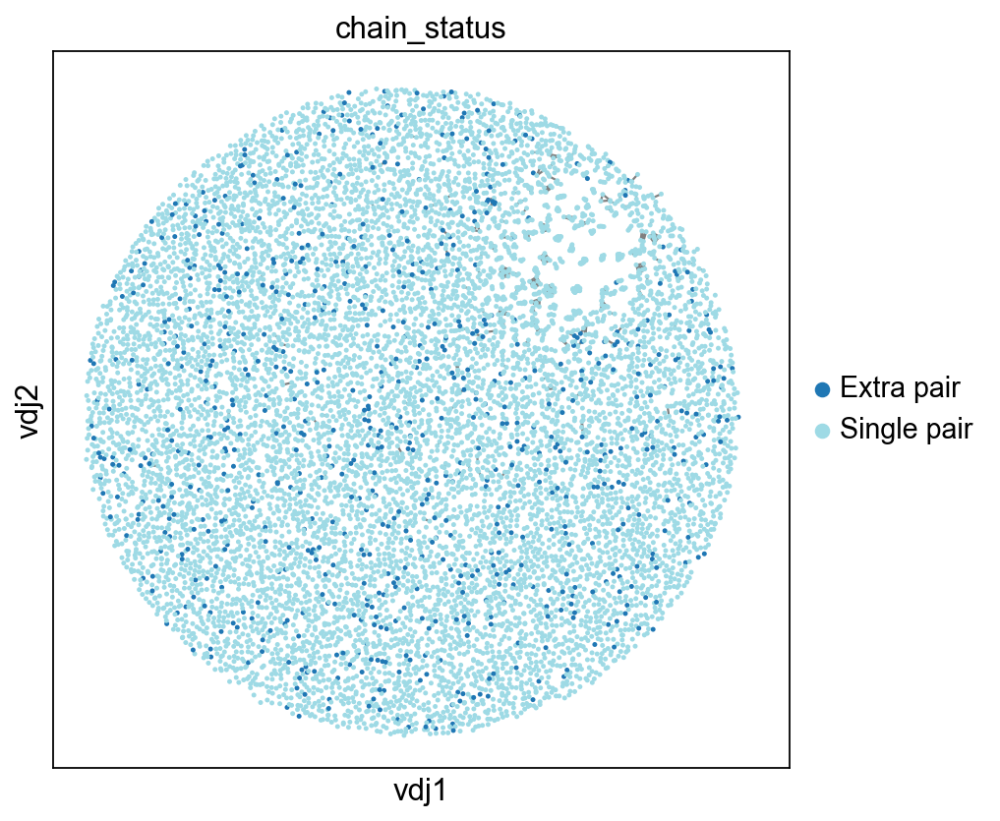

In [40]:
# Set figure parameters
sc.set_figure_params(figsize=[6, 6])

# Create the clone network plot
ddl.pl.clone_network(
    adata_filtered,
    color=["chain_status"],
    ncols=1, palette="tab20", 
    legend_fontoutline=3,
    edges_width=1,
    size=20,
    show=False
)

plt.show()

In [41]:
adata_filtered

AnnData object with n_obs × n_vars = 10051 × 21606
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'mitoPercent', 'riboPercent', 'log10GenesPerUMI', 'cells', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'pANN_0.25_0.2_119', 'doublet_finder', 'pANN_0.25_0.06_24', 'pANN_0.25_0.04_39', 'pANN_0.25_0.02_12', 'pANN_0.25_0.03_91', 'pANN_0.25_0.07_280', 'pANN_0.25_0.22_1074', 'pANN_0.25_0.001_10', 'pANN_0.25_0.04_361', 'pANN_0.25_0.07_34', 'pANN_0.25_0.03_88', 'pANN_0.25_0.07_94', 'pANN_0.25_0.14_932', 'pANN_0.25_0.03_391', 'pANN_0.25_0.28_2189', 'pANN_0.25_0.1_1074', 'pANN_0.25_0.1_171', 'pANN_0.25_0.03_362', 'pANN_0.25_0.01_24', 'pANN_0.25_0.11_345', 'pANN_0.25_0.04_205', 'pANN_0.25_0.07_223', 'pANN_0.25_0.11_438', 'pANN_0.25_0.2_76', 'pANN_0.25_0.23_60', 'pANN_0.25_0.06_25', 'pANN_0.25_0.29_2023', 'pANN_0.25_0.27_1708', 'Disease', 'Sampletype', 'Patient', 'Center', 'samplename', 'harmony_clusters', 'annotate', 'sample_id', 'has_contig', 'locus_VDJ', 'lo

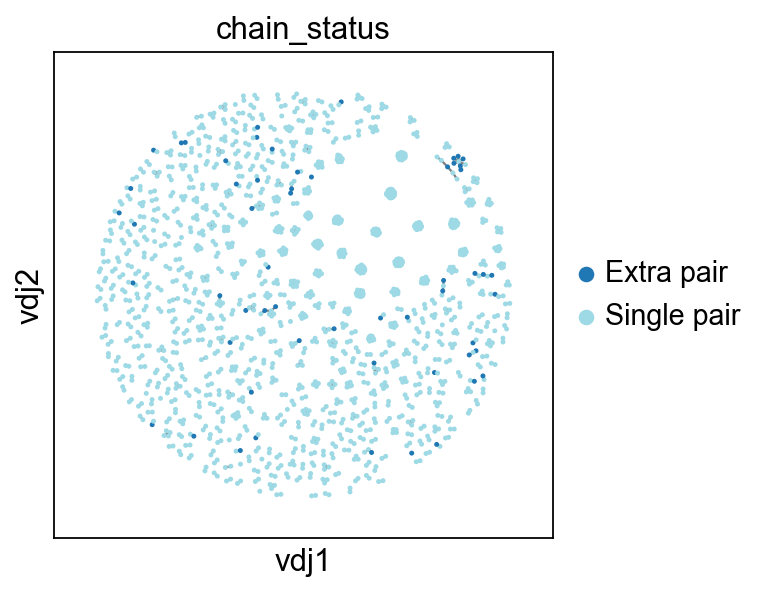

In [42]:
sc.set_figure_params(figsize=[4, 4])
ddl.pl.clone_network(adata_filtered2, color=["chain_status"], ncols=1,
    legend_fontoutline=3, palette="tab20", edges_width=1, size=20, show = False)

plt.show()

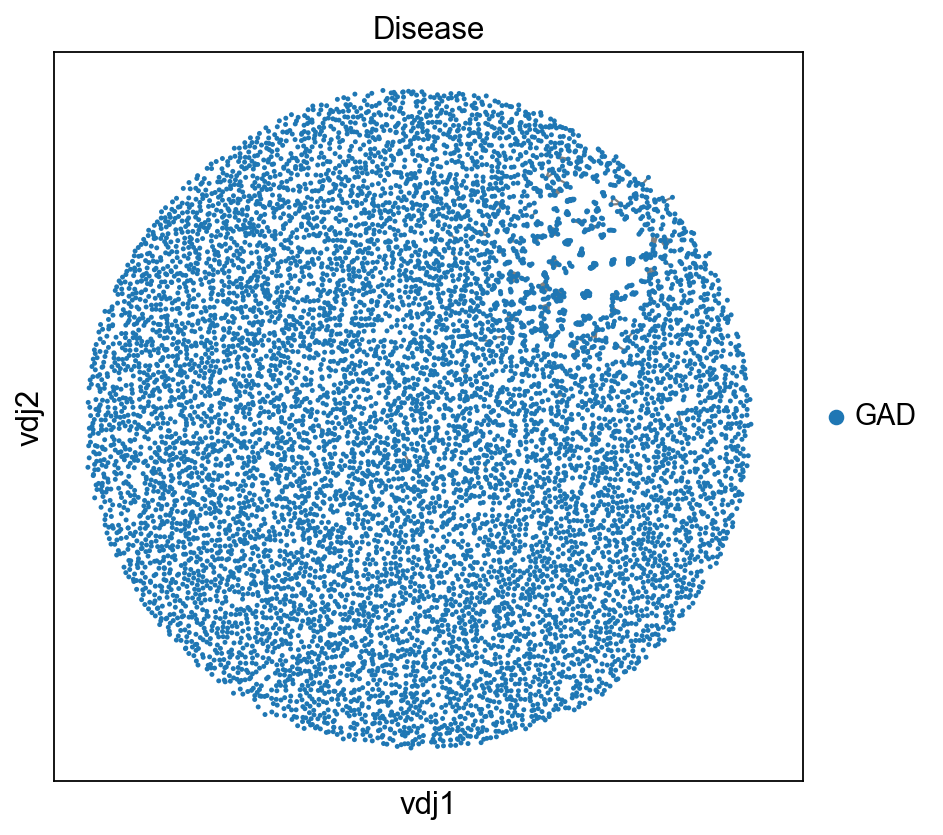

In [43]:
sc.set_figure_params(figsize=[6, 6])

#color_palette = [tab20(0), tab20(19)]
ddl.pl.clone_network(adata_filtered, color=["Disease"], ncols=1,
    legend_fontoutline=3, edges_width=1, palette="tab20", size=20, show = False)
plt.show()

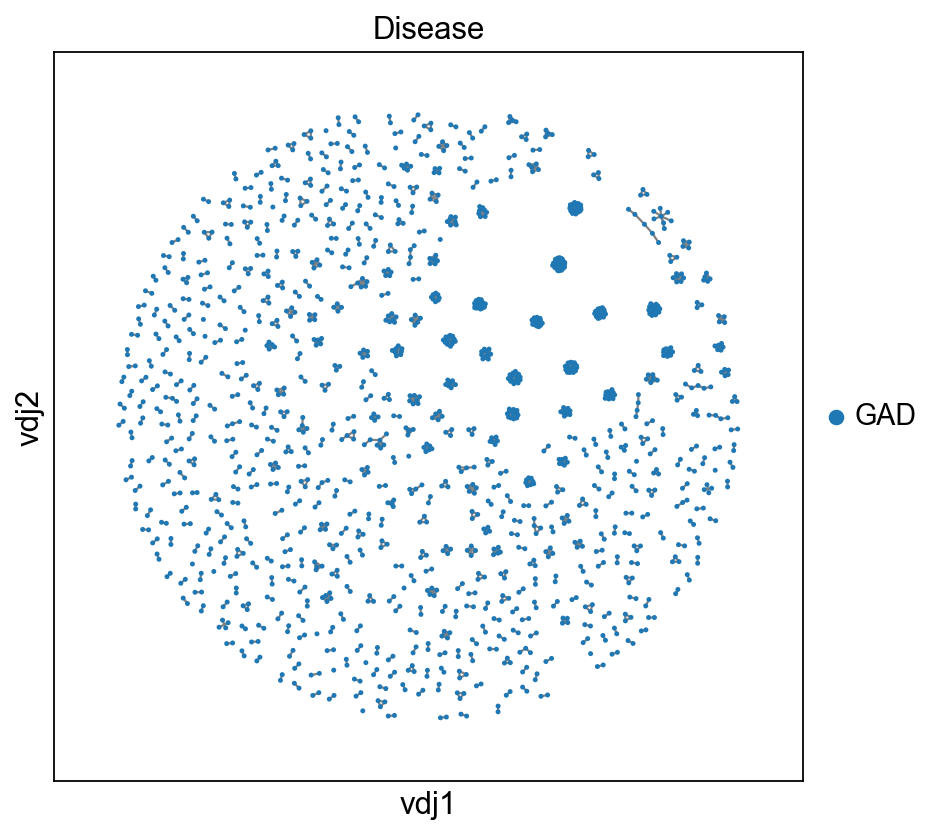

In [45]:
sc.set_figure_params(figsize=[6, 6])

#color_palette = [tab20(0), tab20(19)]
ddl.pl.clone_network(adata_filtered2, color=["Disease"], ncols=1,
    legend_fontoutline=3, edges_width=1, palette="tab20", size=20, show = False)
plt.show()

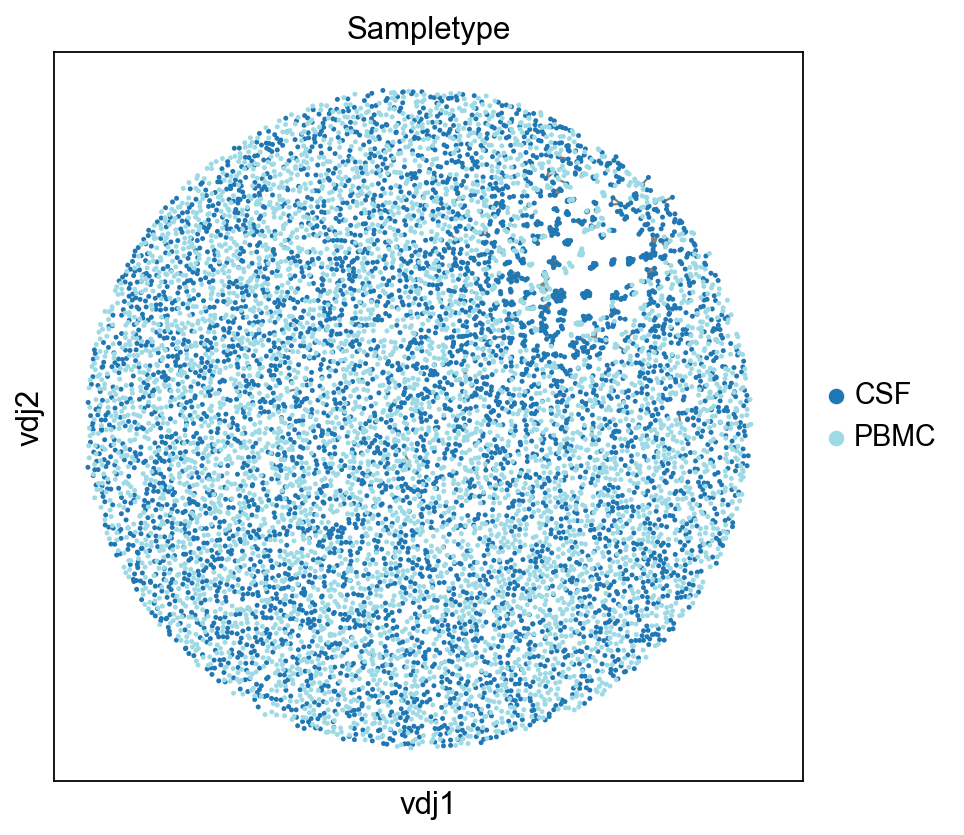

In [44]:
sc.set_figure_params(figsize=[6, 6])

#color_palette = [tab20(0), tab20(19)]
ddl.pl.clone_network(adata_filtered, color=["Sampletype"], ncols=1,
    legend_fontoutline=3, edges_width=1, palette="tab20", size=20, show = False)
plt.show()

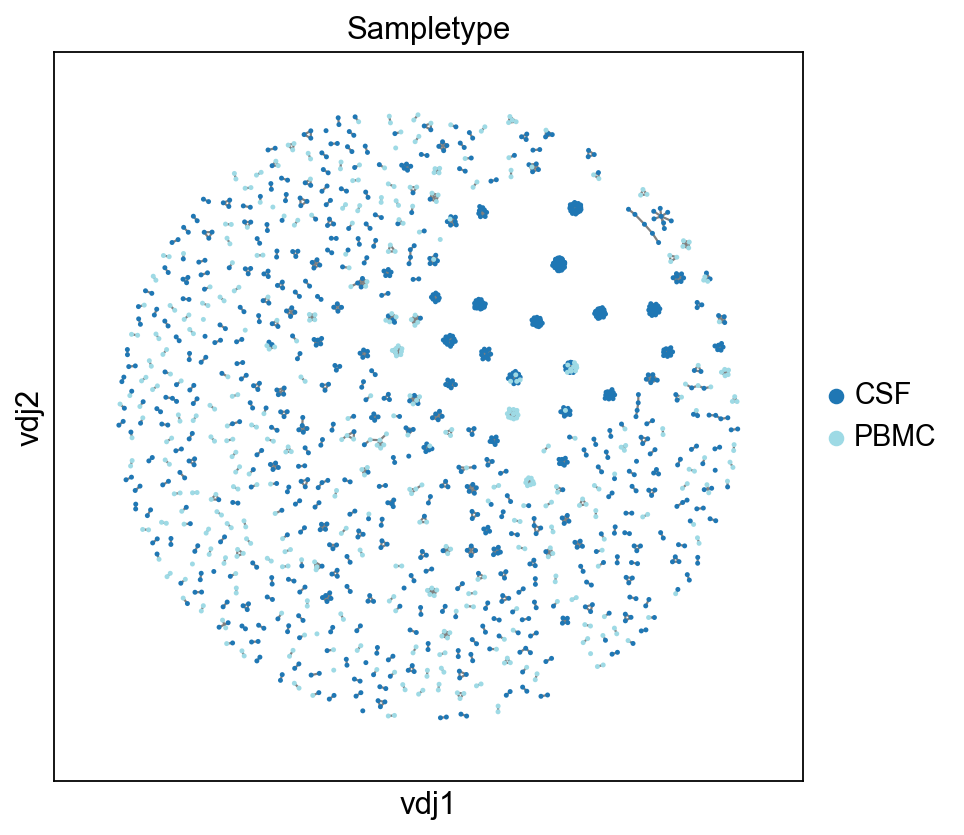

In [46]:
sc.set_figure_params(figsize=[6, 6])

#color_palette = [tab20(0), tab20(19)]
ddl.pl.clone_network(adata_filtered2, color=["Sampletype"], ncols=1,
    legend_fontoutline=3, edges_width=1, palette="tab20", size=20, show = False)
plt.show()

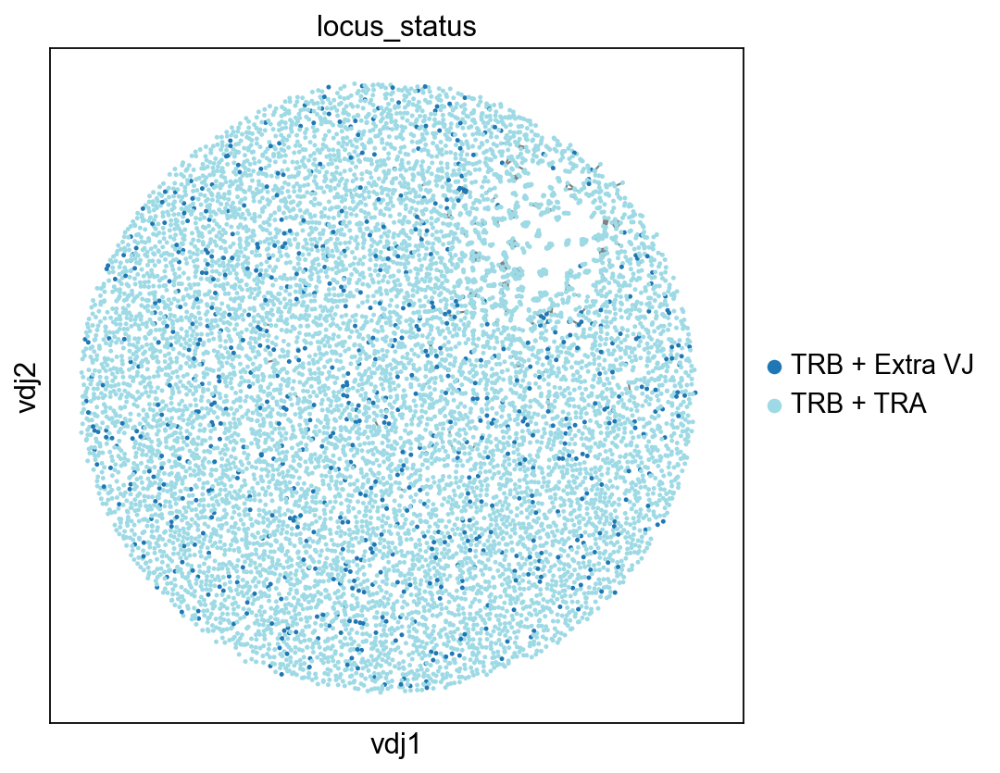

In [47]:

# Set figure parameters
sc.set_figure_params(figsize=[6, 6])

# Create the clone network plot
ddl.pl.clone_network(
    adata_filtered,
    color=["locus_status"],
    ncols=1, palette="tab20", 
    legend_fontoutline=3,
    edges_width=1,
    size=20,
    show=False,
    return_fig=True
)

plt.show()


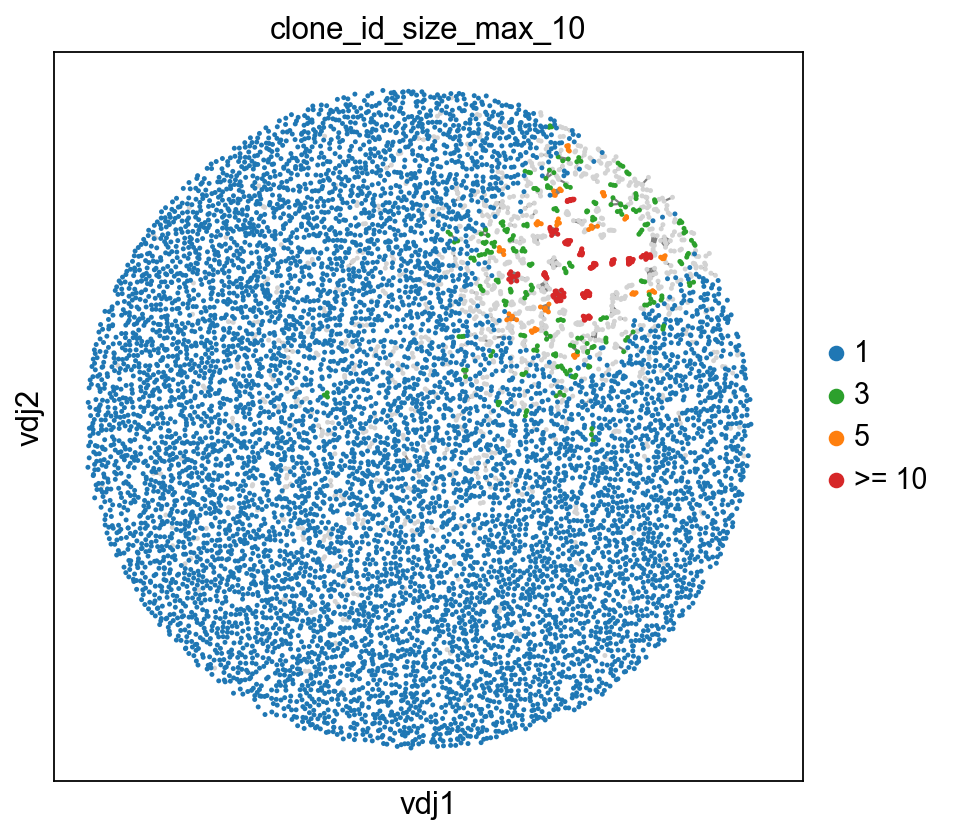

In [57]:
sc.set_figure_params(figsize=[6, 6])
# Get the tab20 colormap
tab20 = plt.cm.tab20

# Select specific colors from tab20
color_palette = [tab20(0), tab20(6), tab20(4), tab20(6), tab20(2), tab20(6)]
ddl.pl.clone_network(
    adata_filtered,
    color=["clone_id_size_max_10"],
     groups=["1", "3", "5", ">= 10"],
    ncols=2,
    legend_fontoutline=3,
    edges_width=1,
    palette=color_palette,
    size=20,
    na_in_legend=False, show=False
    
)

plt.show()

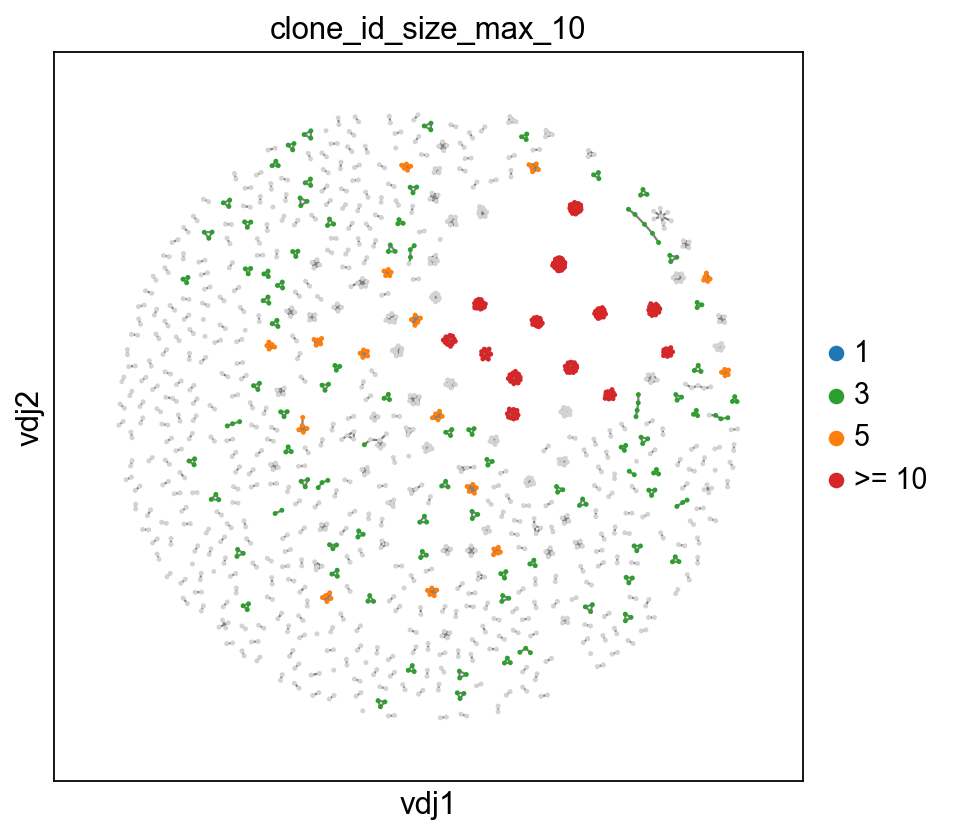

In [58]:
sc.set_figure_params(figsize=[6, 6])
# Get the tab20 colormap
tab20 = plt.cm.tab20

# Select specific colors from tab20
color_palette = [tab20(0), tab20(6), tab20(4), tab20(6), tab20(2), tab20(6)]
ddl.pl.clone_network(
    adata_filtered2,
    color=["clone_id_size_max_10"],
     groups=["1", "3", "5", ">= 10"],
    ncols=2,
    legend_fontoutline=3,
    edges_width=1,
    palette=color_palette,
    size=20,
    na_in_legend=False, show=False
    
)

plt.show()

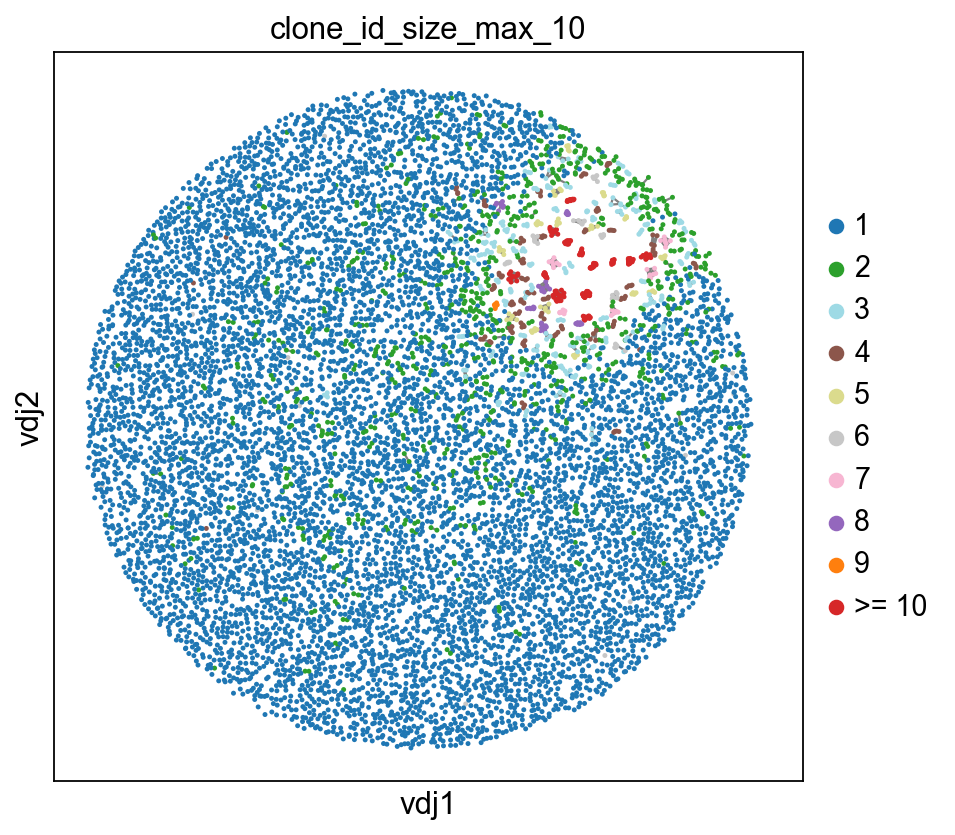

In [60]:
sc.set_figure_params(figsize=[6, 6])

# Get the tab20 colormap
tab20 = plt.cm.tab20

# Select specific colors from tab20
color_palette = [tab20(0), tab20(4), tab20(19), tab20(10), tab20(17), tab20(15), tab20(13), tab20(8), tab20(2), tab20(6)] 
ddl.pl.clone_network(
    adata_filtered,
    color=["clone_id_size_max_10"],
    
    ncols=2,
    legend_fontoutline=3,
    edges_width=1,
    palette=color_palette,
    size=20,
    na_in_legend=False, show=False
    
)

plt.show()

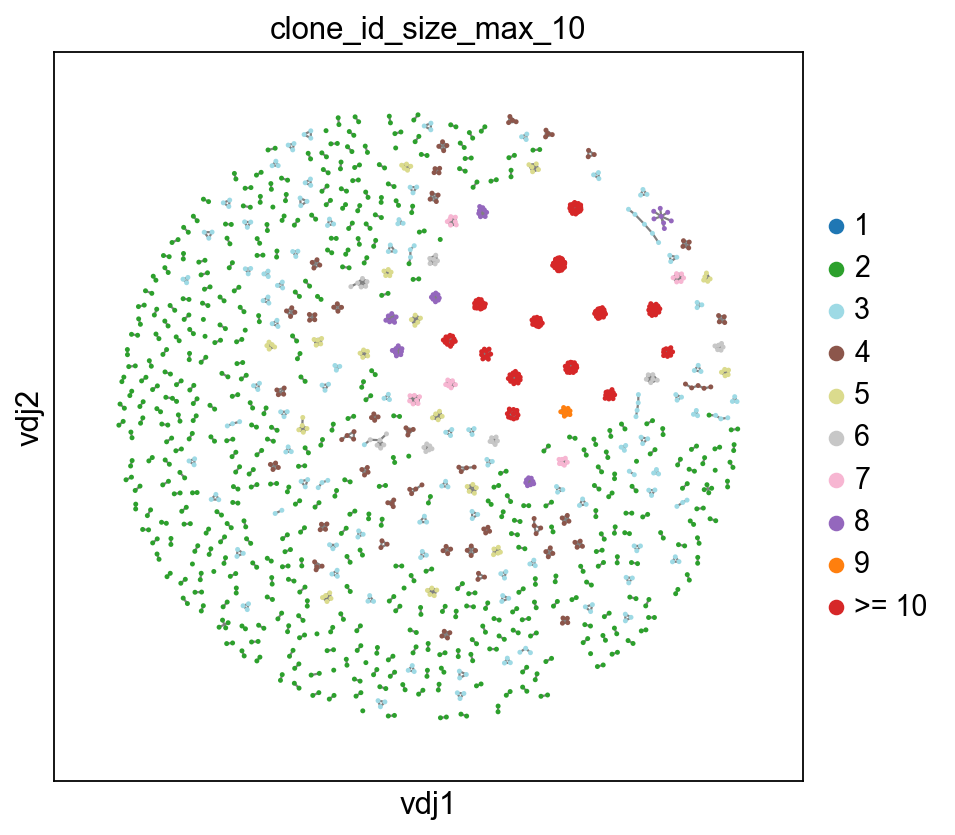

In [62]:
sc.set_figure_params(figsize=[6, 6])

# Get the tab20 colormap
tab20 = plt.cm.tab20

# Select specific colors from tab20
color_palette = [tab20(0), tab20(4), tab20(19), tab20(10), tab20(17), tab20(15), tab20(13), tab20(8), tab20(2), tab20(6)] 
ddl.pl.clone_network(
    adata_filtered2,
    color=["clone_id_size_max_10"],
    
    ncols=2,
    legend_fontoutline=3,
    edges_width=1,
    palette=color_palette,
    size=20,
    na_in_legend=False, show=False
    
)

plt.show()

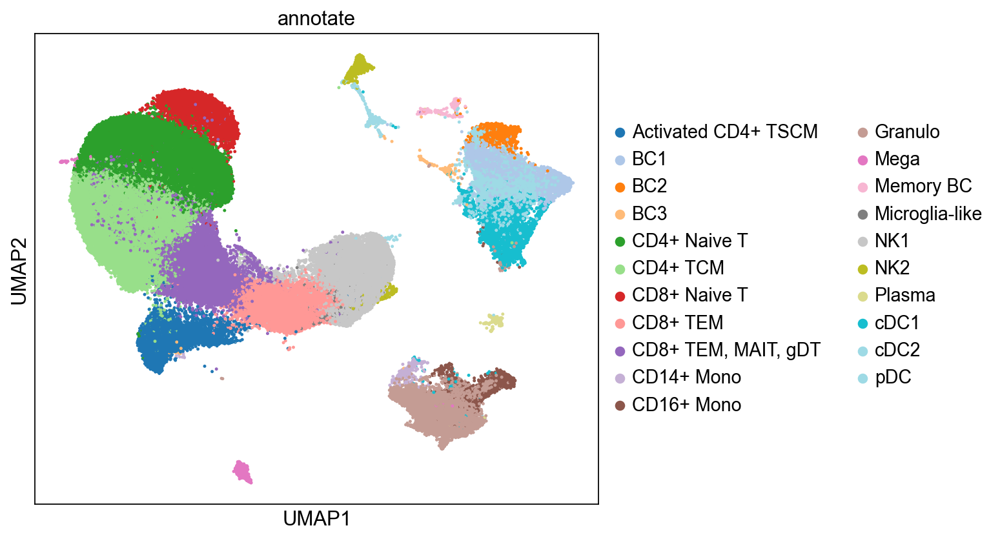

In [67]:

sc.set_figure_params(figsize=[7, 6])
sc.pl.umap(adata, color=["annotate"], na_in_legend=False, palette="tab20", edges_width=1, size=20, show=False)
plt.show()

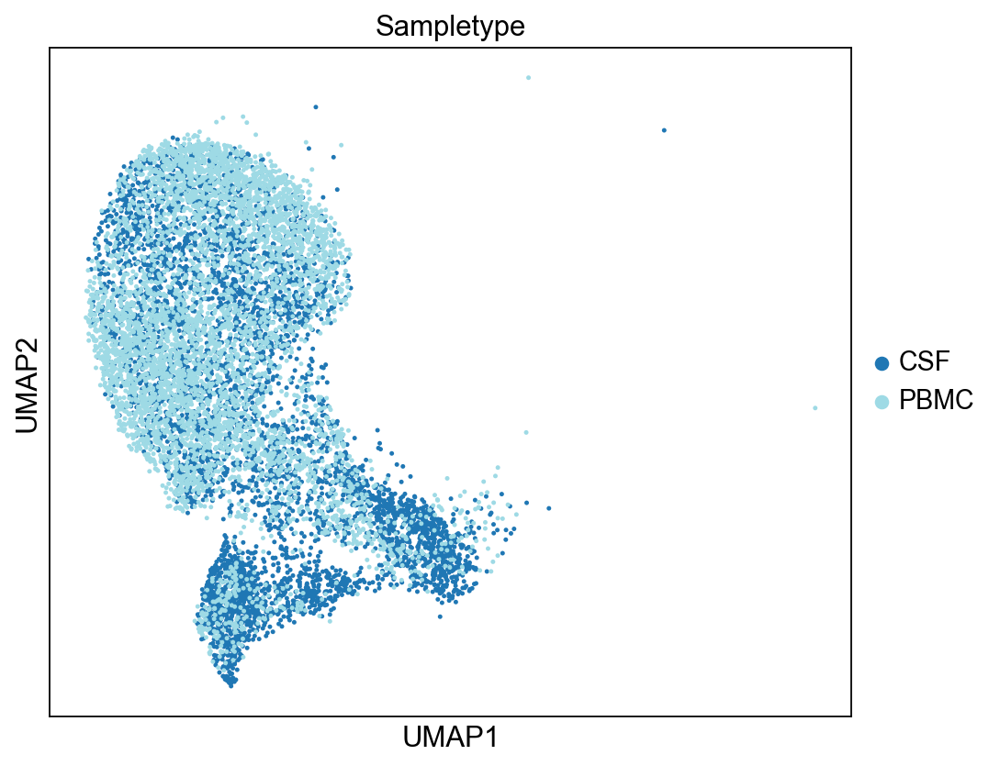

In [63]:

sc.set_figure_params(figsize=[7, 6])
sc.pl.umap(adata_filtered, color=["Sampletype"], na_in_legend=False, palette="tab20", edges_width=1, size=20, show=False)


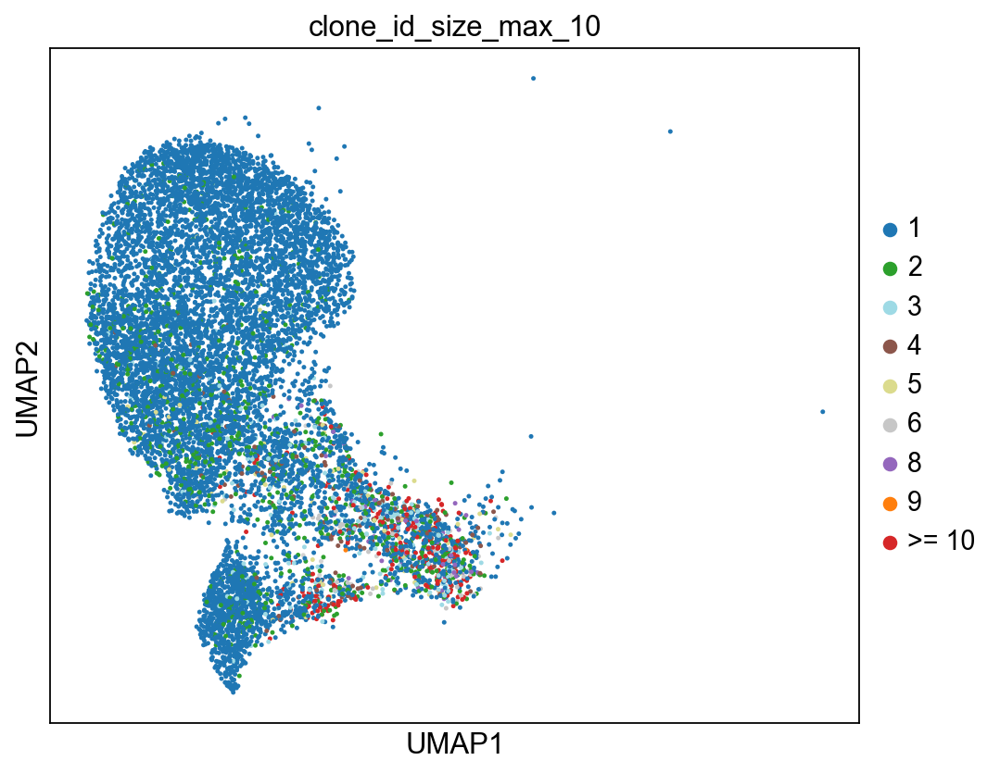

In [64]:

sc.set_figure_params(figsize=[7, 6])
tab20 = plt.cm.tab20

color_palette = [tab20(0), tab20(4), tab20(19), tab20(10), tab20(17), tab20(15), tab20(13), tab20(8), tab20(2), tab20(6)] 

sc.pl.umap(adata_filtered, color=["clone_id_size_max_10"],  groups=["1", "2", "3", "4", "5", "6", "8", "9", ">= 10"], na_in_legend=False, palette=color_palette, edges_width=1, size=20, show=False)
plt.show()

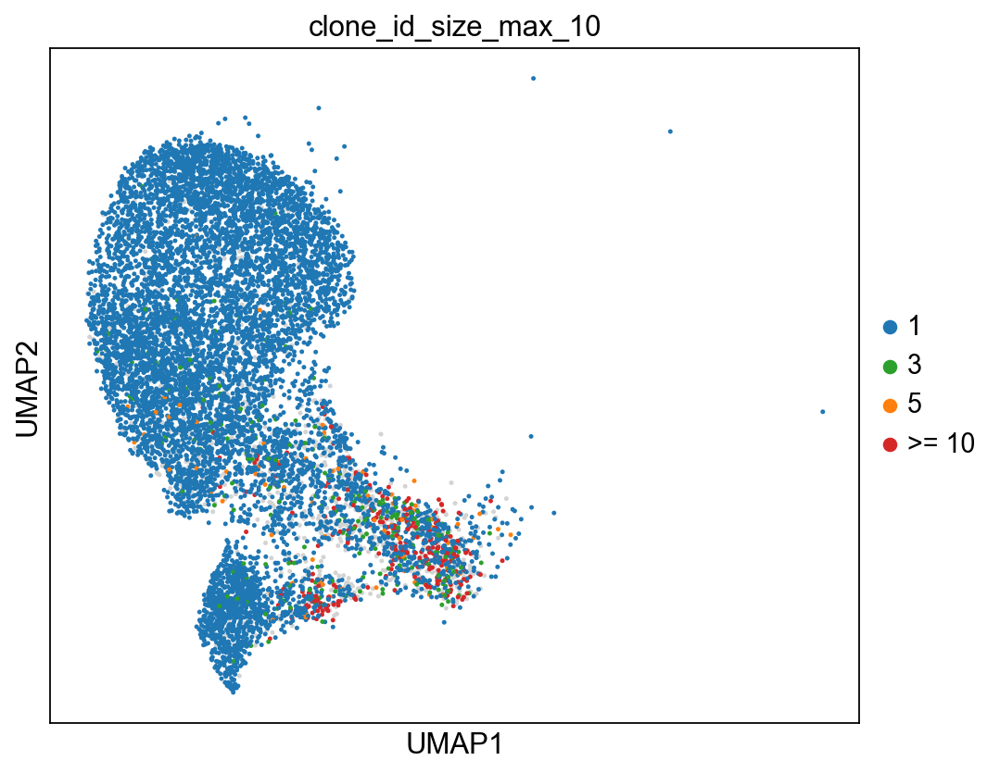

In [66]:
# show where clones/clonotypes have more than 1 cell
sc.set_figure_params(figsize=[7, 6])
# Get the tab20 colormap
tab20 = plt.cm.tab20

# Select specific colors from tab20
color_palette = [tab20(0), tab20(6), tab20(4), tab20(6), tab20(2), tab20(6)]
sc.pl.umap(adata_filtered, color=["clone_id_size_max_10"], groups=["1", "3", "5", ">= 10"], na_in_legend=False, palette=color_palette, edges_width=1, size=20, show=False)
plt.show()

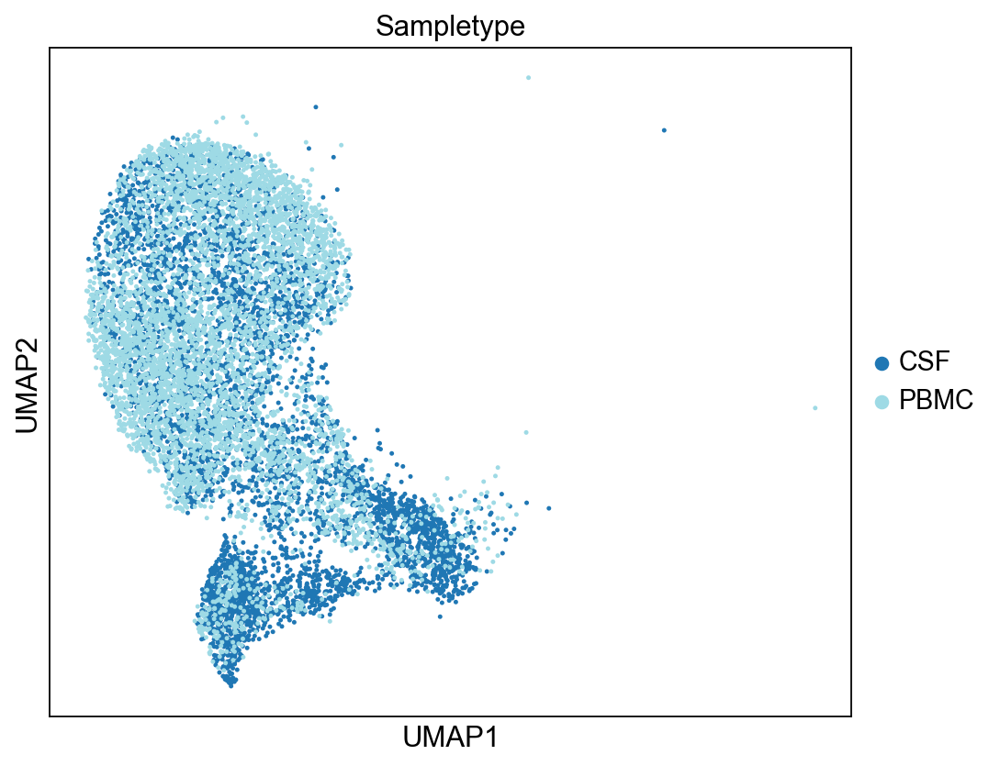

In [67]:
# show where clones/clonotypes have more than 1 cell
sc.set_figure_params(figsize=[7, 6])
sc.pl.umap(adata_filtered, color=["Sampletype"], na_in_legend=False, edges_width=1, size=20, show=False)
plt.show()

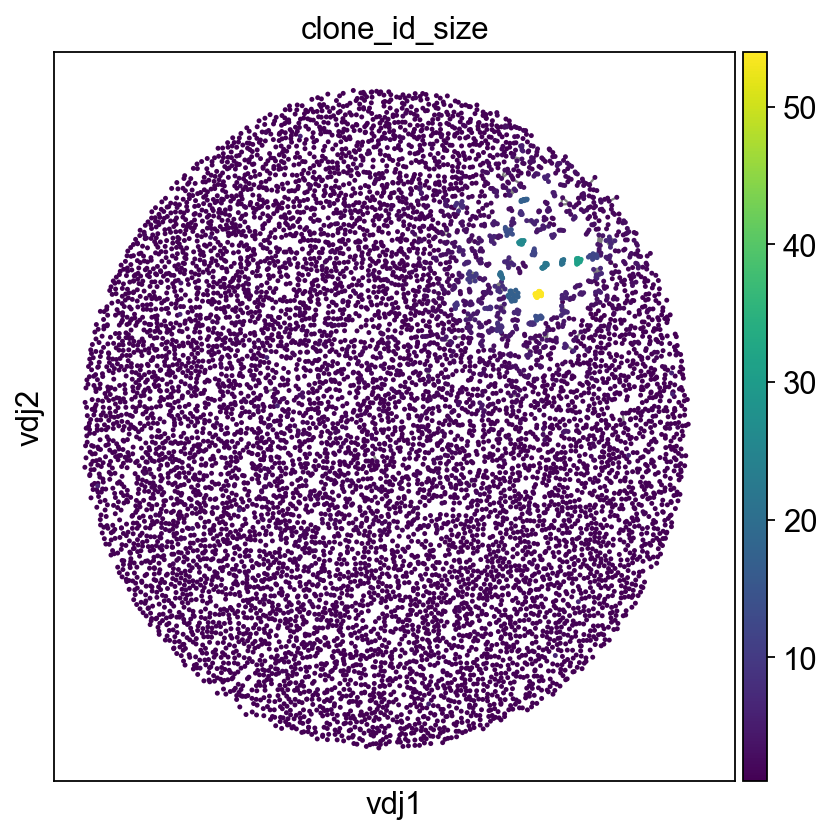

In [68]:
from matplotlib import pyplot as plt
sc.set_figure_params(figsize=[6, 6])
ddl.pl.clone_network(adata_filtered, color='clone_id_size',  edges_width=1, size=20, show = False)   #for tab20 color scale -> color_map="tab20", default viridis
#plt.savefig('GAD_control_PBMC_TCR_clone_size.pdf', dpi=300, bbox_inches='tight')
plt.show()

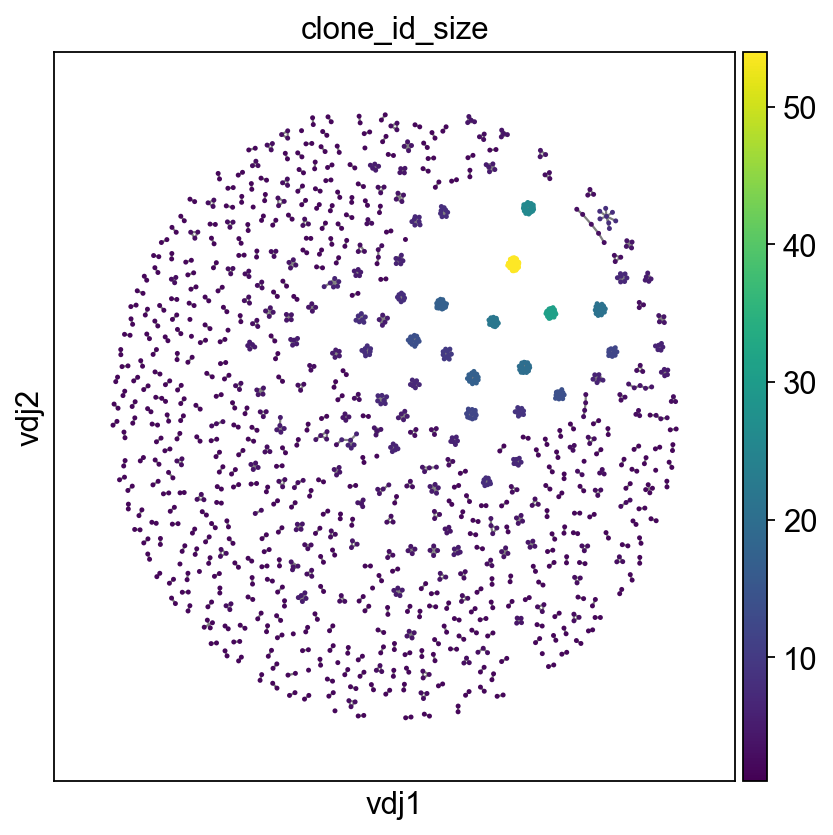

In [69]:
from matplotlib import pyplot as plt
sc.set_figure_params(figsize=[6, 6])
ddl.pl.clone_network(adata_filtered2, color='clone_id_size',  edges_width=1, size=20, show = False)   #for tab20 color scale -> color_map="tab20", default viridis
plt.show()

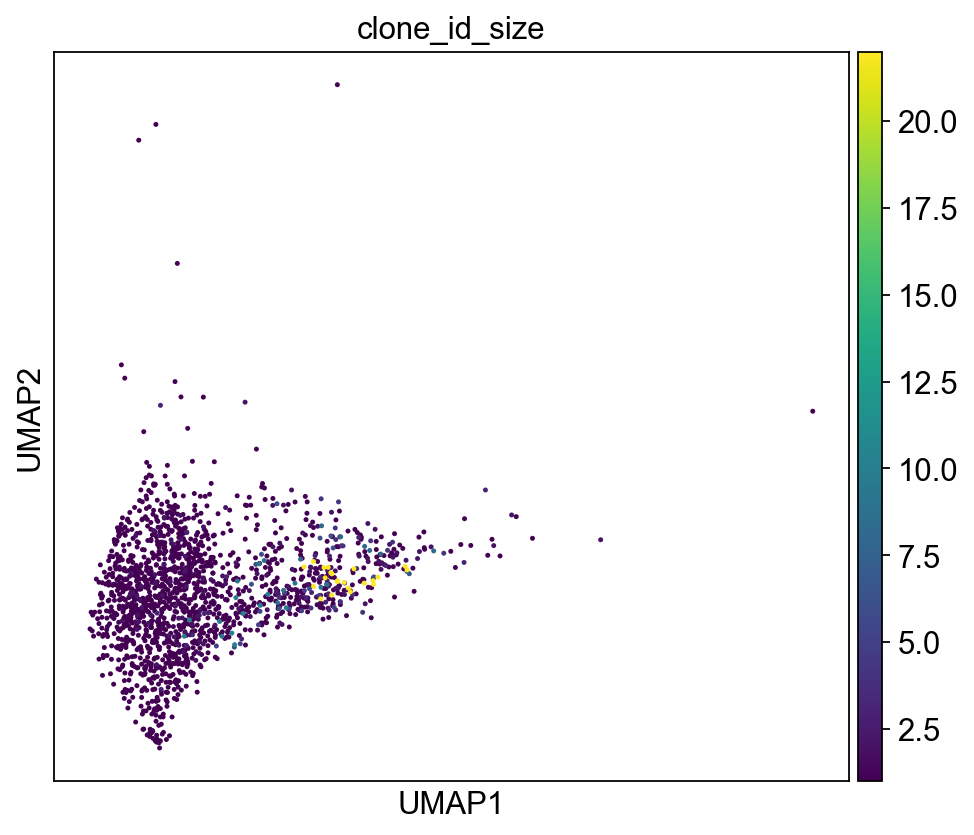

In [102]:

# show where clones/clonotypes have more than 1 cell
sc.set_figure_params(figsize=[7, 6])
sc.pl.umap(adata_filtered, color=["clone_id_size"], na_in_legend=False, edges_width=1, size=20, show=False) #for tab20 color scale -> color_map="tab20", palette="tab20", 
plt.show()

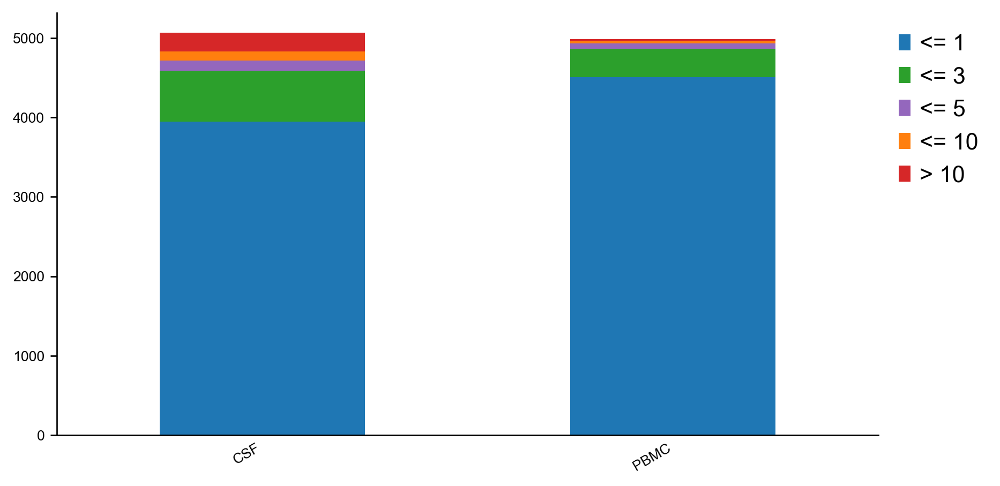

In [72]:
import scirpy as ir
# Set figure parameters
#sc.set_figure_params(figsize=[8, 6])

# Get the number of unique categories in the 'annotate' column
n_categories = len(adata_filtered.obs['Sampletype'].unique())


# Get the tab20 colormap
tab20 = plt.cm.tab20



# Select specific colors from tab20
color_palette = [tab20(0), tab20(4), tab20(8), tab20(2), tab20(6)]
#color_palette = [tab20(0), tab20(4), tab20(8), tab20(2), tab20(6)]  # This selects 5 colors


# Set the color cycle
plt.rcParams['axes.prop_cycle'] = plt.cycler(color=color_palette)

# Create the clonal expansion plot
ax = ir.pl.clonal_expansion(adata_filtered, target_col="clone_id_by_size", groupby="Sampletype", 
                            normalize=False, breakpoints=(1, 3, 5, 10), figsize=(8, 4))

# Move the legend outside the plot
plt.legend(bbox_to_anchor=(1, 1), loc="upper left", frameon=False)

# Adjust the layout to prevent the legend from being cut off
plt.tight_layout()

# Show the plot
plt.show()

In [8]:
# Assuming `clone_id_size` is in `adata.obs`
filtered_adata_exp = adata_filtered[adata_filtered.obs['clone_id_size'] > 1]
filtered_adata_exp

View of AnnData object with n_obs × n_vars = 1689 × 21606
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'mitoPercent', 'riboPercent', 'log10GenesPerUMI', 'cells', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.8', 'seurat_clusters', 'pANN_0.25_0.2_119', 'doublet_finder', 'pANN_0.25_0.06_24', 'pANN_0.25_0.04_39', 'pANN_0.25_0.02_12', 'pANN_0.25_0.03_91', 'pANN_0.25_0.07_280', 'pANN_0.25_0.22_1074', 'pANN_0.25_0.001_10', 'pANN_0.25_0.04_361', 'pANN_0.25_0.07_34', 'pANN_0.25_0.03_88', 'pANN_0.25_0.07_94', 'pANN_0.25_0.14_932', 'pANN_0.25_0.03_391', 'pANN_0.25_0.28_2189', 'pANN_0.25_0.1_1074', 'pANN_0.25_0.1_171', 'pANN_0.25_0.03_362', 'pANN_0.25_0.01_24', 'pANN_0.25_0.11_345', 'pANN_0.25_0.04_205', 'pANN_0.25_0.07_223', 'pANN_0.25_0.11_438', 'pANN_0.25_0.2_76', 'pANN_0.25_0.23_60', 'pANN_0.25_0.06_25', 'pANN_0.25_0.29_2023', 'pANN_0.25_0.27_1708', 'Disease', 'Sampletype', 'Patient', 'Center', 'samplename', 'harmony_clusters', 'annotate', 'sample_id', 'has_contig', 'locus_VD

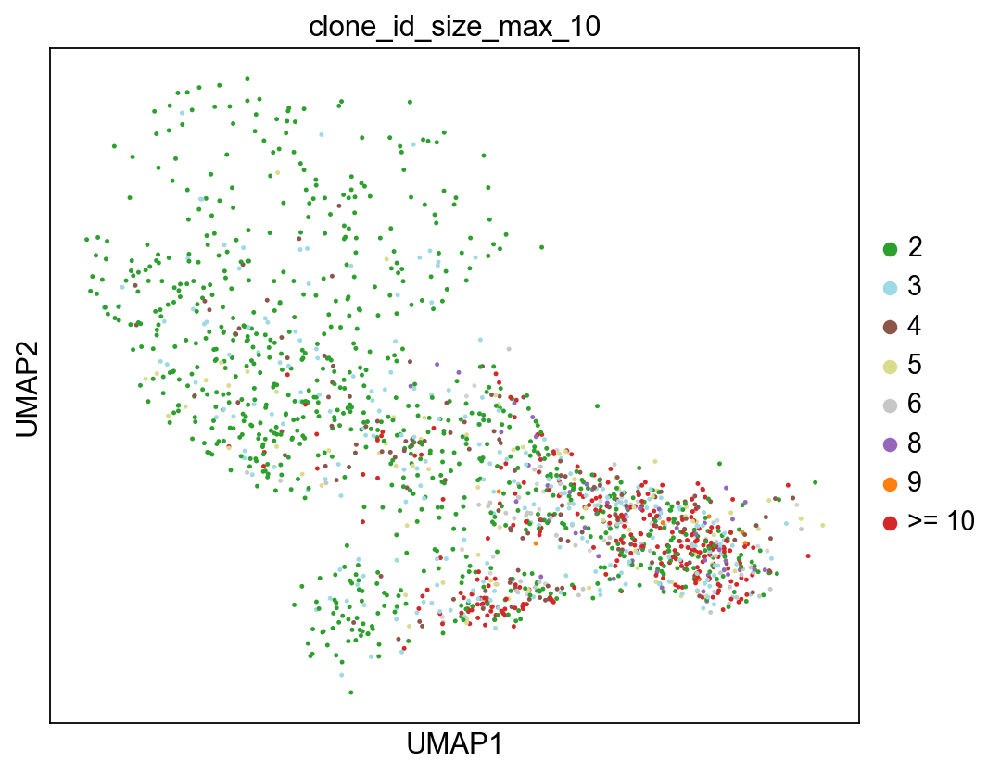

In [9]:
# show where clones/clonotypes have more than 1 cell
sc.set_figure_params(figsize=[7, 6])
# Get the tab20 colormap
tab20 = plt.cm.tab20

# Select specific colors from tab20
#color_palette = [tab20(0), tab20(4), tab20(19), tab20(8), tab20(10), tab20(2), tab20(6)] 

color_palette = [tab20(4), tab20(19), tab20(10), tab20(17), tab20(15), tab20(13), tab20(8), tab20(2), tab20(6)] 

sc.pl.umap(filtered_adata_exp, color=["clone_id_size_max_10"],  groups=["2", "3", "4", "5", "6", "8", "9", ">= 10"], na_in_legend=False, palette=color_palette, edges_width=1, size=20, show=False)
plt.show()

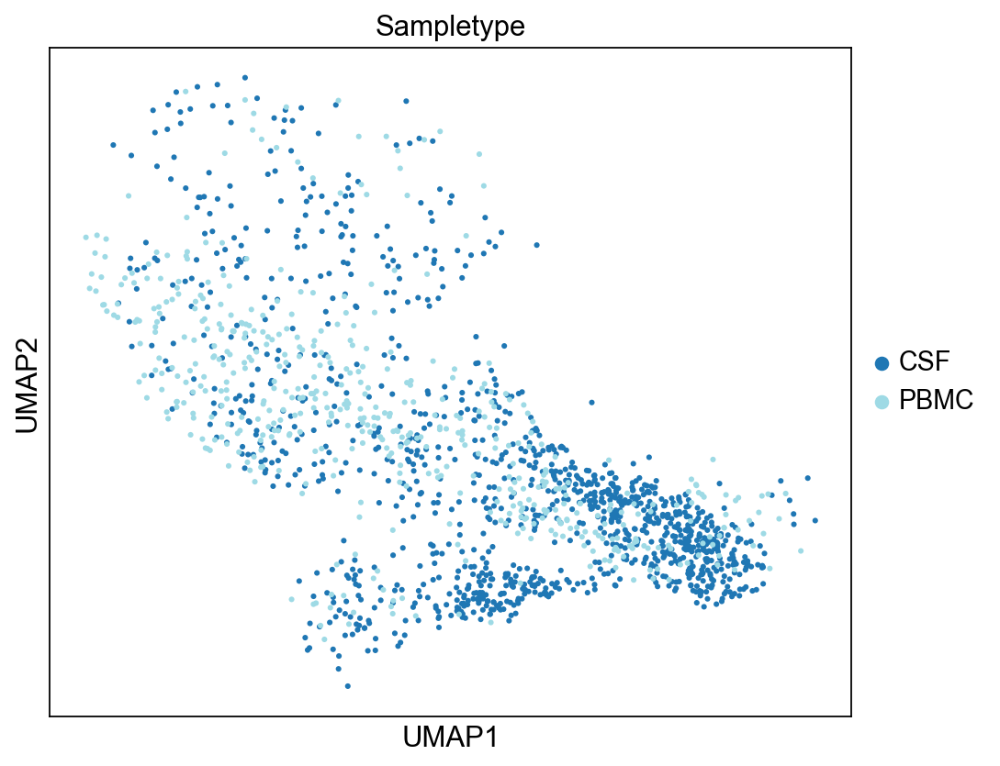

In [10]:
# show where clones/clonotypes have more than 1 cell
sc.set_figure_params(figsize=[7, 6])
sc.pl.umap(filtered_adata_exp, color=["Sampletype"], na_in_legend=False, palette="tab20", edges_width=1, size=30, show=False)
plt.show()

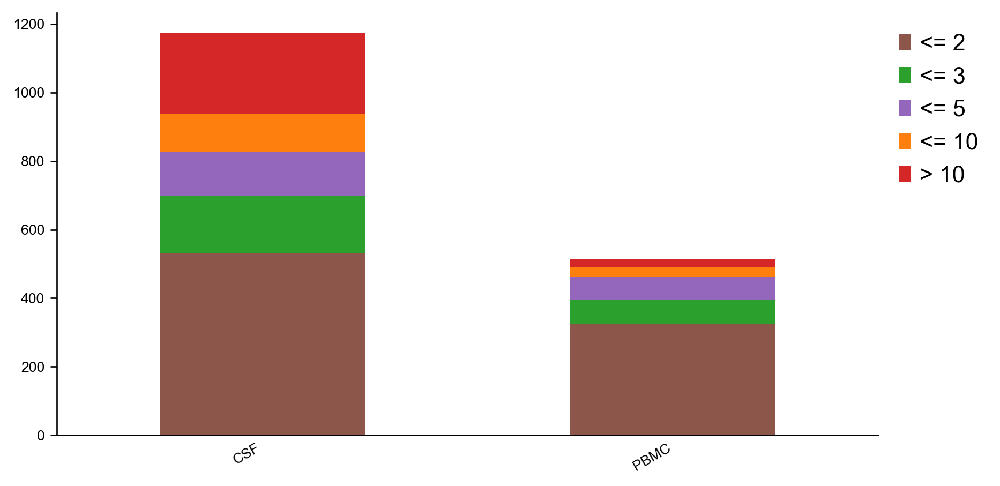

In [11]:
import scirpy as ir
# Set figure parameters
#sc.set_figure_params(figsize=[8, 6])

# Get the number of unique categories in the 'annotate' column
n_categories = len(filtered_adata_exp.obs['Sampletype'].unique())


# Get the tab20 colormap
tab20 = plt.cm.tab20



# Select specific colors from tab20
color_palette = [tab20(10), tab20(4), tab20(8), tab20(2), tab20(6)]
#color_palette = [tab20(0), tab20(4), tab20(8), tab20(2), tab20(6)]  # This selects 5 colors


# Set the color cycle
plt.rcParams['axes.prop_cycle'] = plt.cycler(color=color_palette)

# Create the clonal expansion plot
ax = ir.pl.clonal_expansion(filtered_adata_exp, target_col="clone_id_by_size", groupby="Sampletype", 
                            normalize=False, breakpoints=(2, 3, 5, 10), figsize=(8, 4))

# Move the legend outside the plot
plt.legend(bbox_to_anchor=(1, 1), loc="upper left", frameon=False)

# Adjust the layout to prevent the legend from being cut off
plt.tight_layout()

# Show the plot
plt.show()

Scirpy: clonotype analysis

<Axes: >

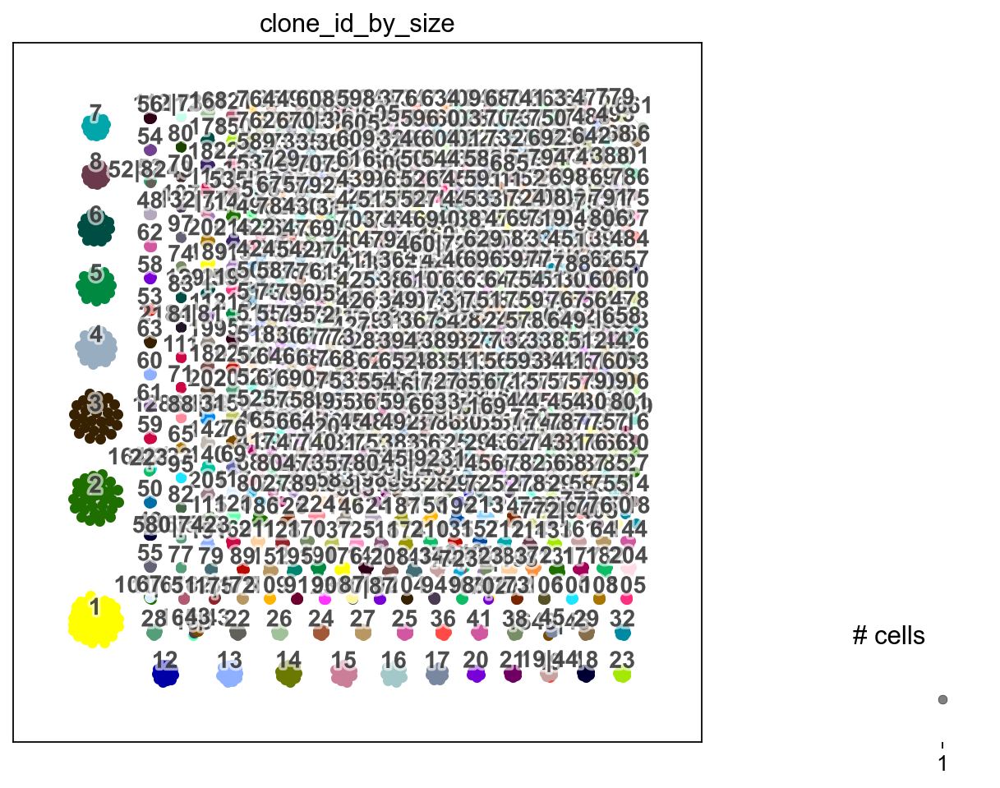

In [12]:
ddl.tl.transfer(adata_filtered, vdj, clone_key="clone_id_by_size")
ir.tl.clonotype_network(adata_filtered, clonotype_key="clone_id_by_size", min_cells=2)
ir.pl.clonotype_network(adata_filtered, color="clone_id_by_size", panel_size=(7, 7))


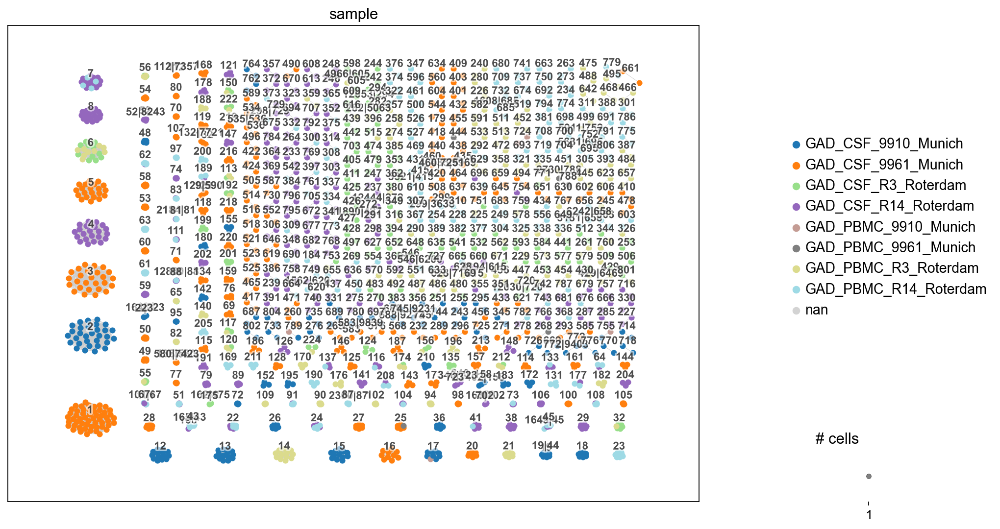

In [81]:
ir.pl.clonotype_network(adata_filtered, color="sample", base_size=20, palette="tab20", label_fontsize=10, panel_size=(12, 8))

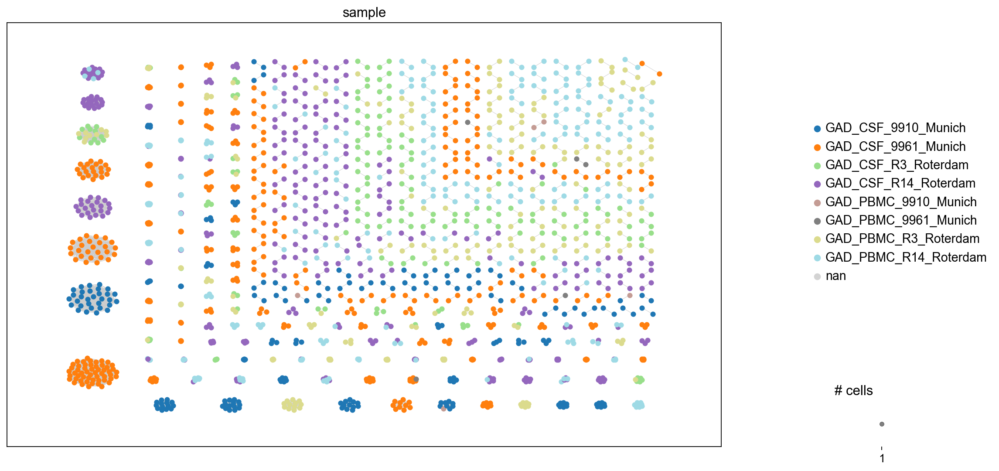

In [13]:
ir.pl.clonotype_network(adata_filtered, color="sample", base_size=20, palette="tab20", show_labels=False, label_fontsize=10, panel_size=(14, 8))


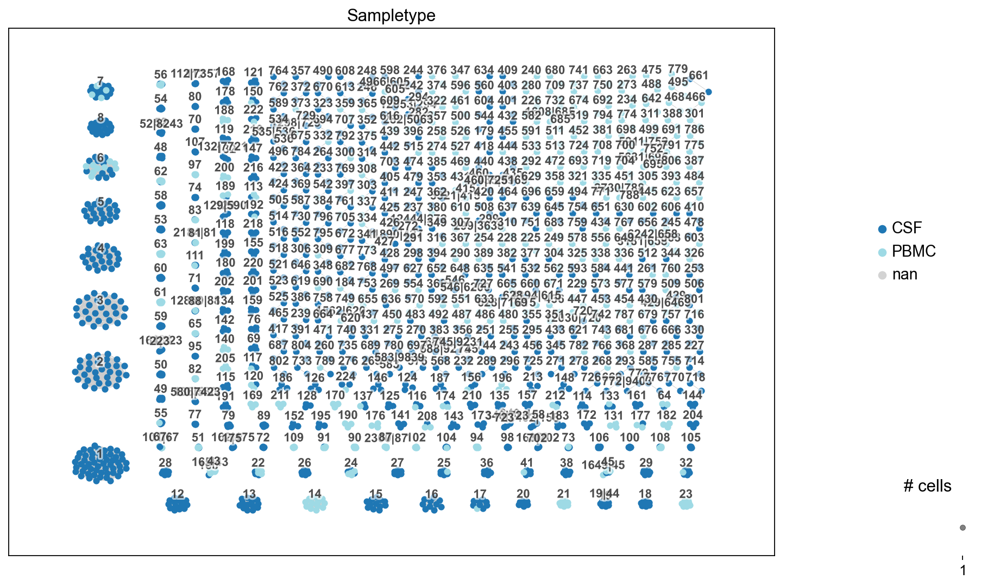

In [80]:
ir.pl.clonotype_network(adata_filtered, color="Sampletype", base_size=20, palette="tab20", label_fontsize=10, panel_size=(12, 8))

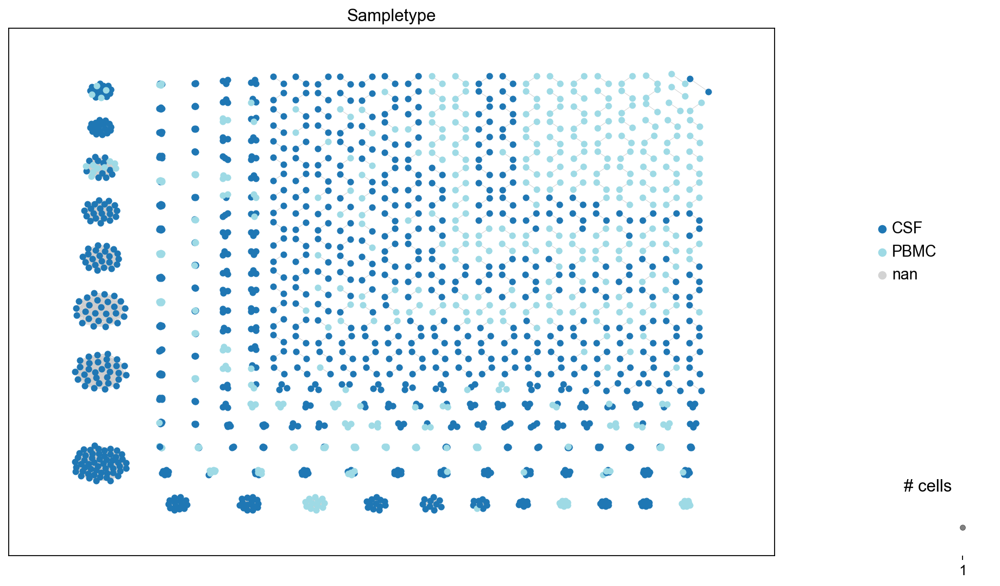

In [14]:
ir.pl.clonotype_network(adata_filtered, color="Sampletype", base_size=20, palette="tab20", show_labels=False, label_fontsize=10, panel_size=(12, 8))

<Axes: >

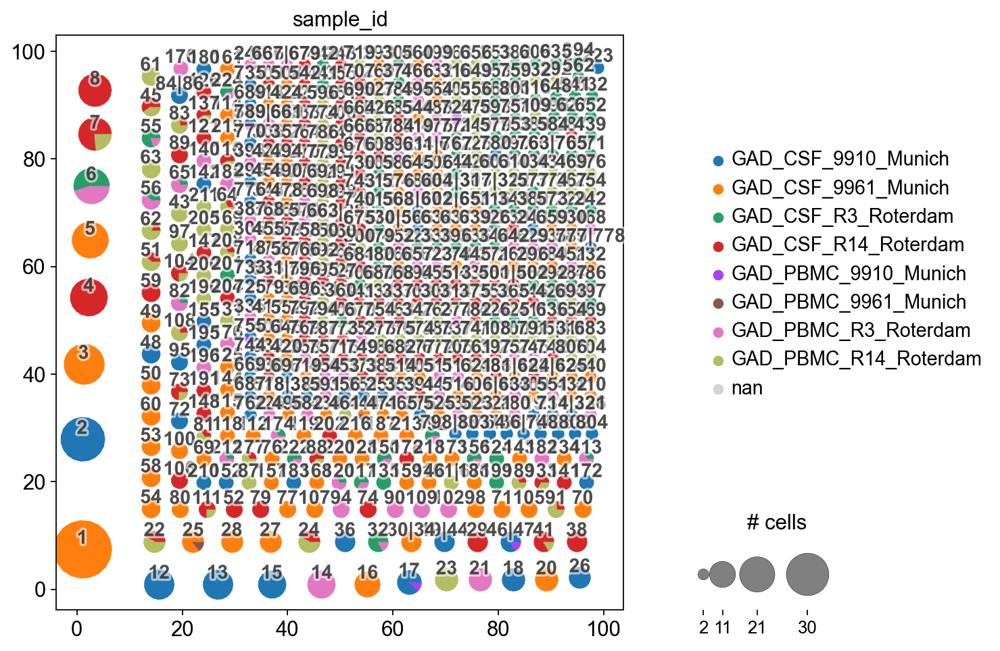

In [24]:
ddl.tl.transfer(adata_filtered, vdj, clone_key="clone_id_by_size", collapse_nodes=True)
ir.tl.clonotype_network(adata_filtered, clonotype_key="clone_id_by_size", min_cells=2)
ir.pl.clonotype_network(adata_filtered, color="sample_id", panel_size=(7, 7))

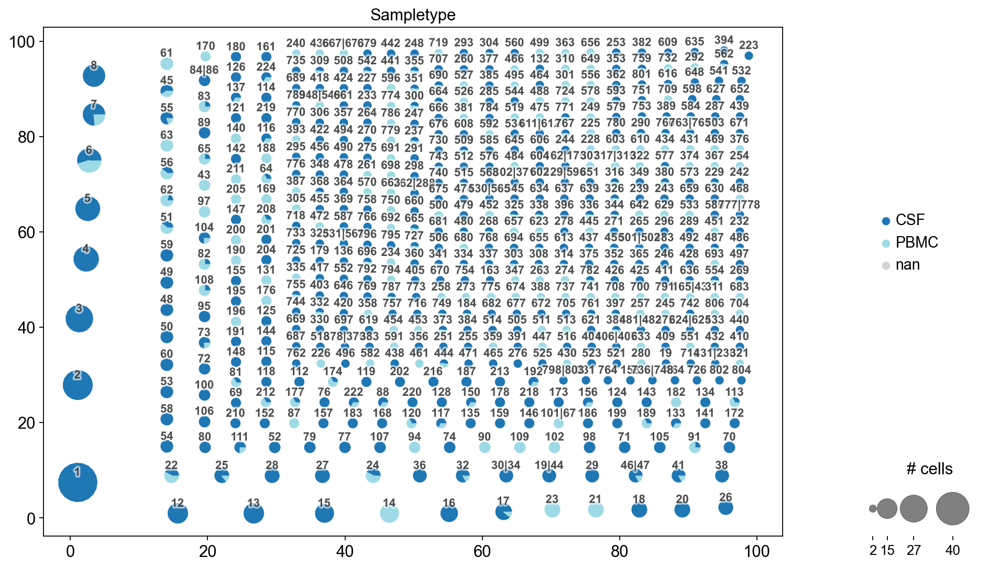

In [85]:

ir.pl.clonotype_network(adata_filtered, color="Sampletype", base_size=20, label_fontsize=10, panel_size=(12, 8))


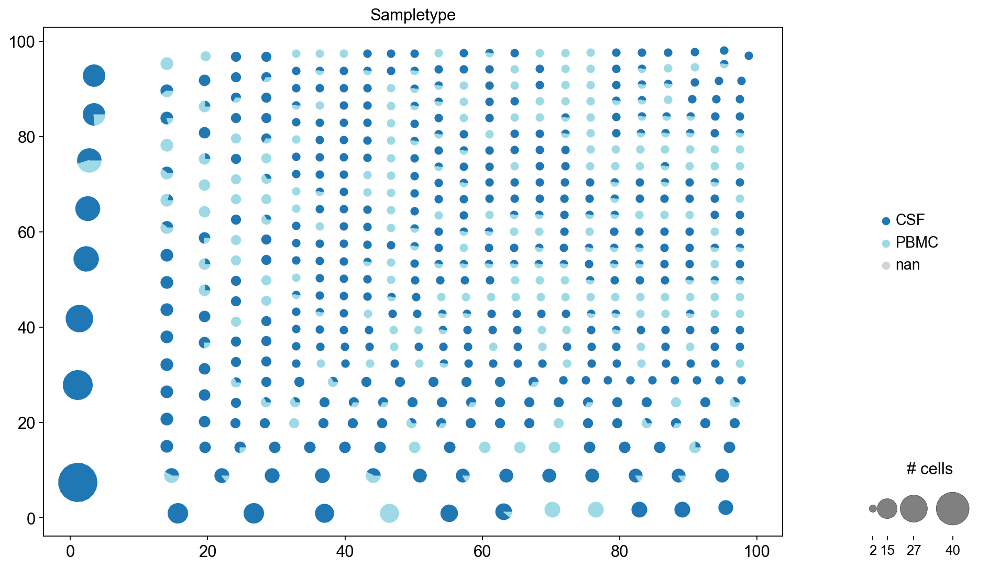

In [16]:

ir.pl.clonotype_network(adata_filtered, color="Sampletype", base_size=20, show_labels=False, label_fontsize=10, panel_size=(12, 8))


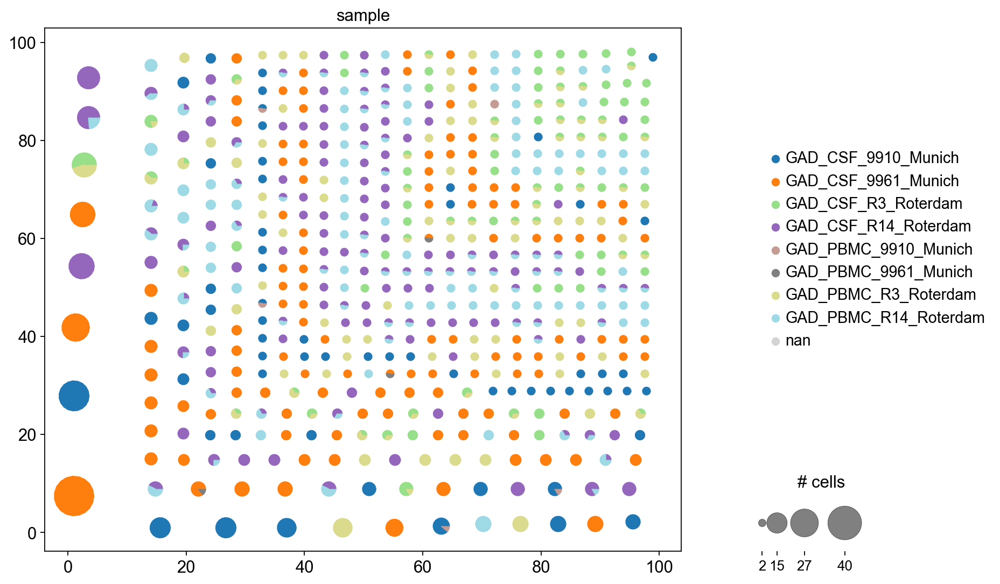

In [25]:
ir.pl.clonotype_network(adata_filtered, color="sample", base_size=20, label_fontsize=12, show_labels=False, panel_size=(10, 8))


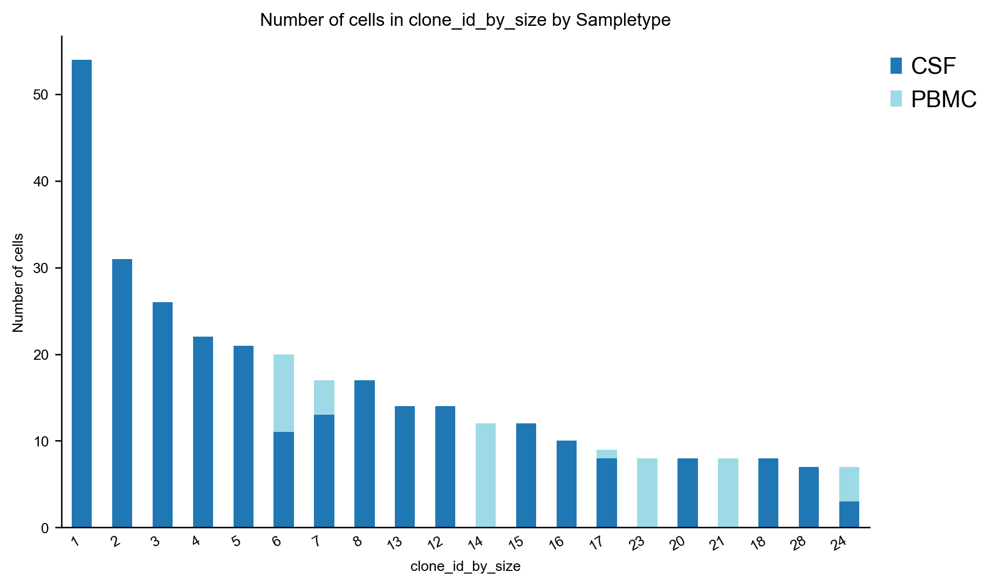

In [87]:
ir.pl.group_abundance(adata_filtered, groupby="clone_id_by_size", target_col="Sampletype", max_cols=20, figsize=(8, 5))

# Move the legend outside the plot
plt.legend(bbox_to_anchor=(1, 1), loc="upper left", frameon=False)


min 5 cells

<Axes: >

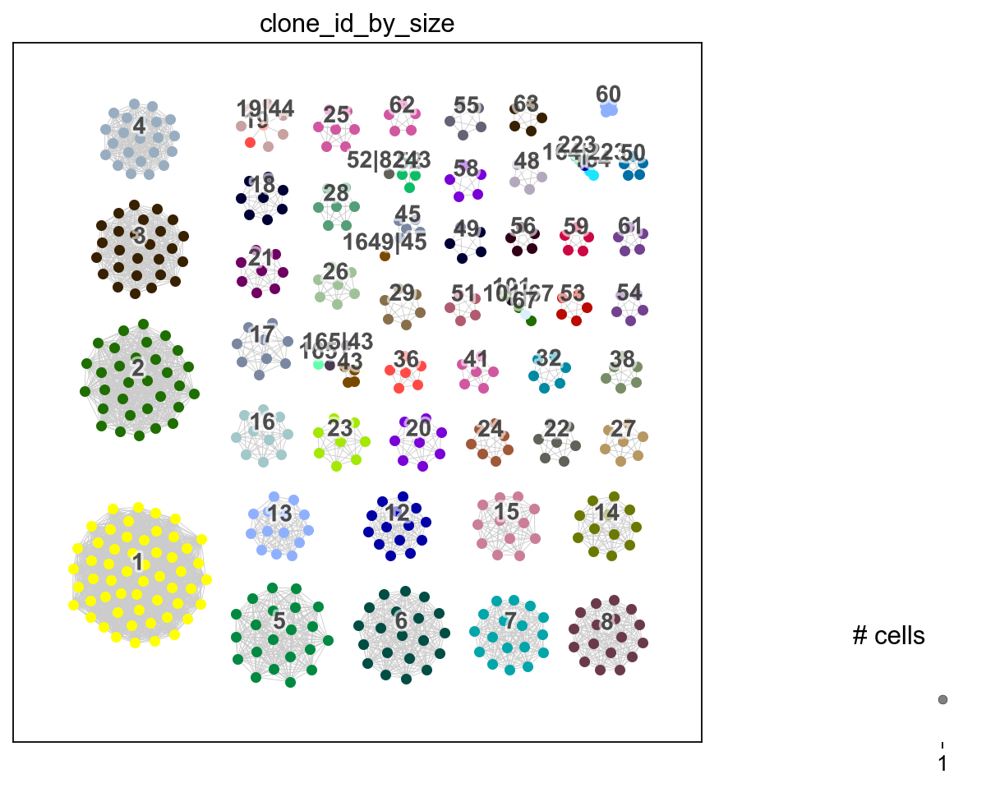

In [17]:
ddl.tl.transfer(adata_filtered, vdj, clone_key="clone_id_by_size")
ir.tl.clonotype_network(adata_filtered, clonotype_key="clone_id_by_size", min_cells=5)
ir.pl.clonotype_network(adata_filtered, color="clone_id_by_size", panel_size=(7, 7))

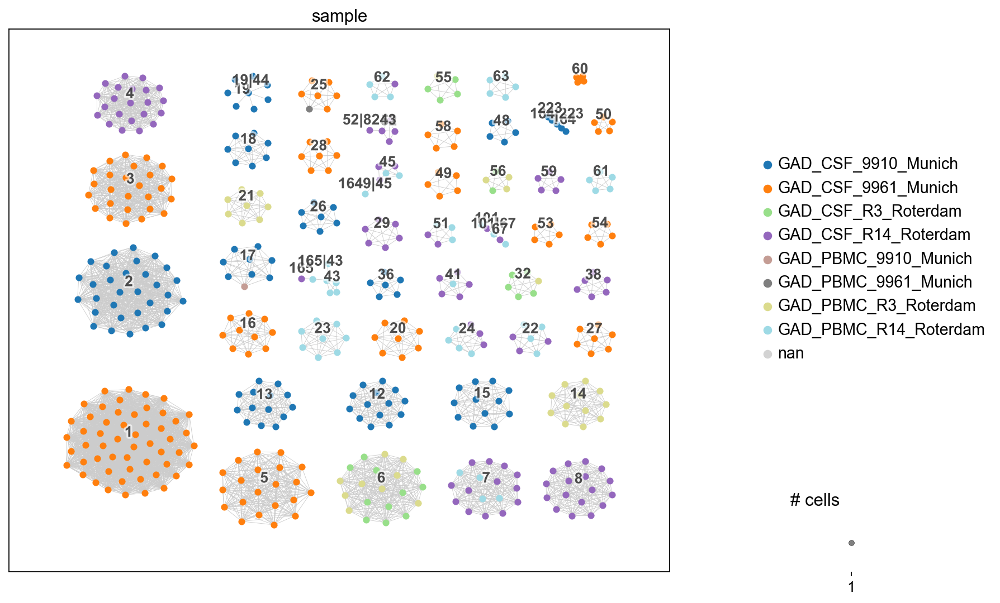

In [94]:
ir.pl.clonotype_network(adata_filtered, color="sample", base_size=20, palette="tab20", label_fontsize=12, panel_size=(10, 8))


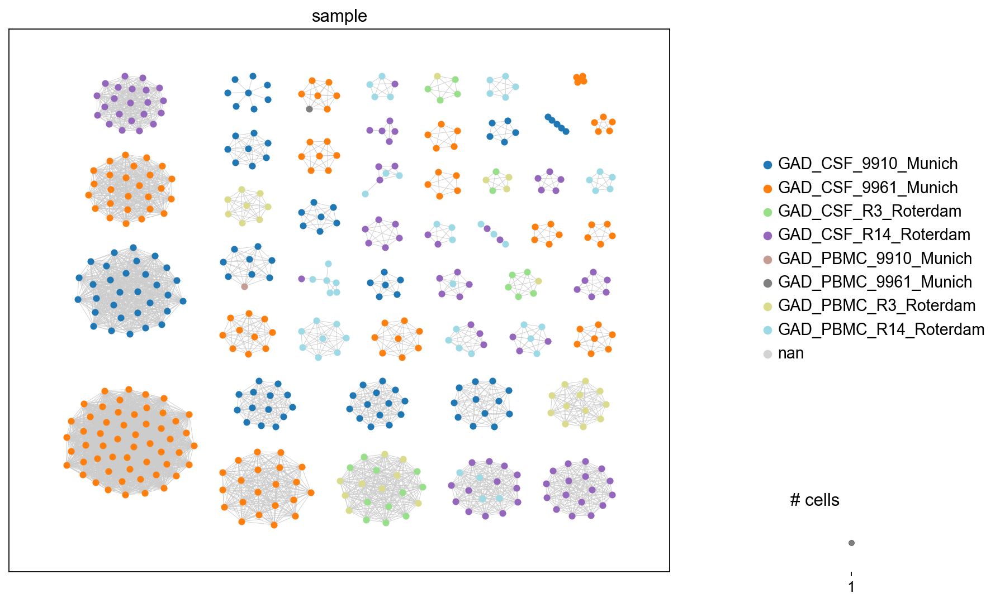

In [18]:
ir.pl.clonotype_network(adata_filtered, color="sample", base_size=20, palette="tab20", show_labels=False, label_fontsize=12, panel_size=(10, 8))


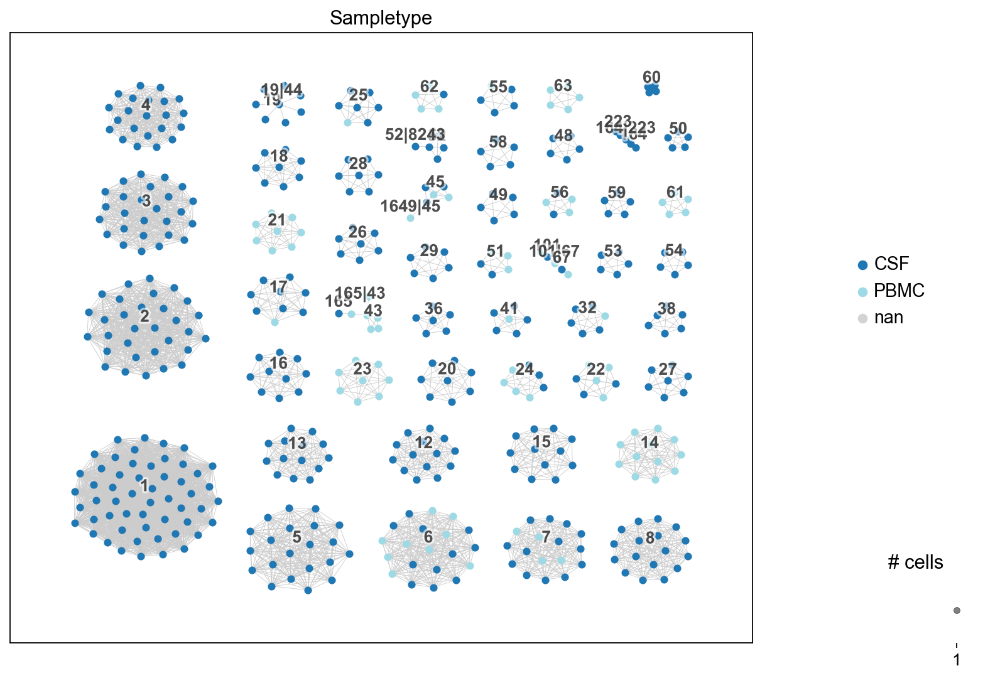

In [96]:
ir.pl.clonotype_network(adata_filtered, color="Sampletype", base_size=20, palette="tab20", label_fontsize=12, panel_size=(10, 8))

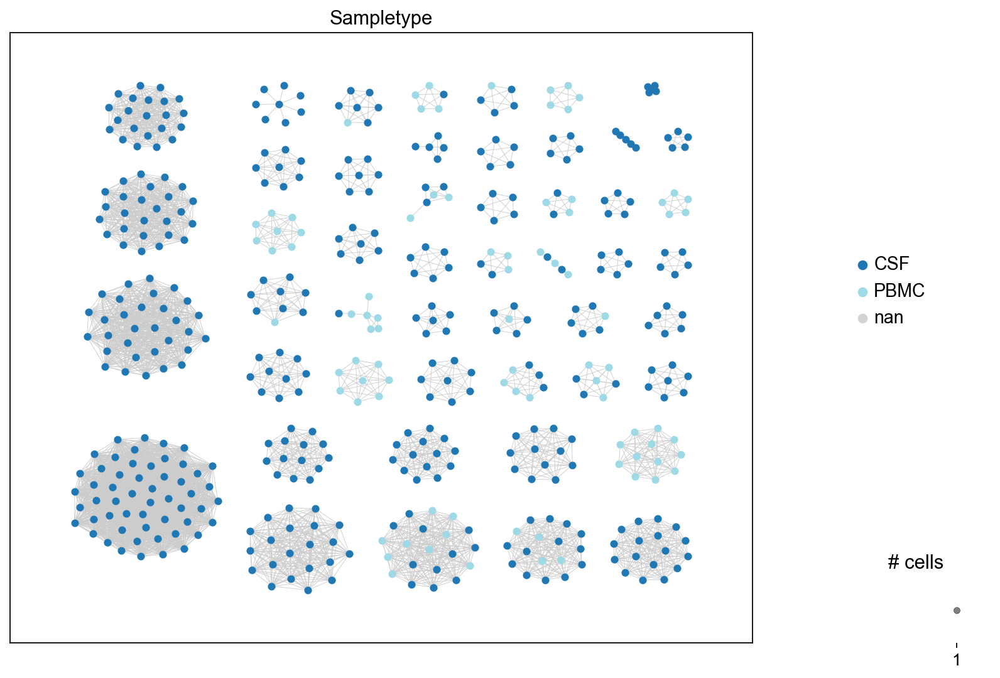

In [19]:
ir.pl.clonotype_network(adata_filtered, color="Sampletype", base_size=20, palette="tab20", show_labels=False, label_fontsize=12, panel_size=(10, 8))


<Axes: >

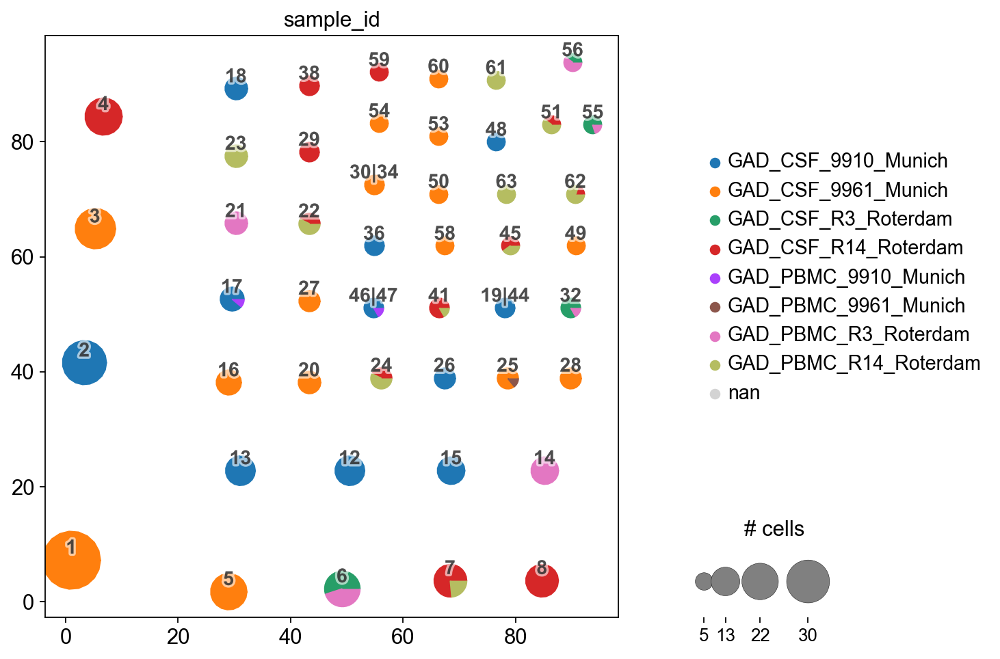

In [20]:
ddl.tl.transfer(adata_filtered, vdj, clone_key="clone_id_by_size", collapse_nodes=True)
ir.tl.clonotype_network(adata_filtered, clonotype_key="clone_id_by_size", min_cells=5)
ir.pl.clonotype_network(adata_filtered, color="sample_id", panel_size=(7, 7))

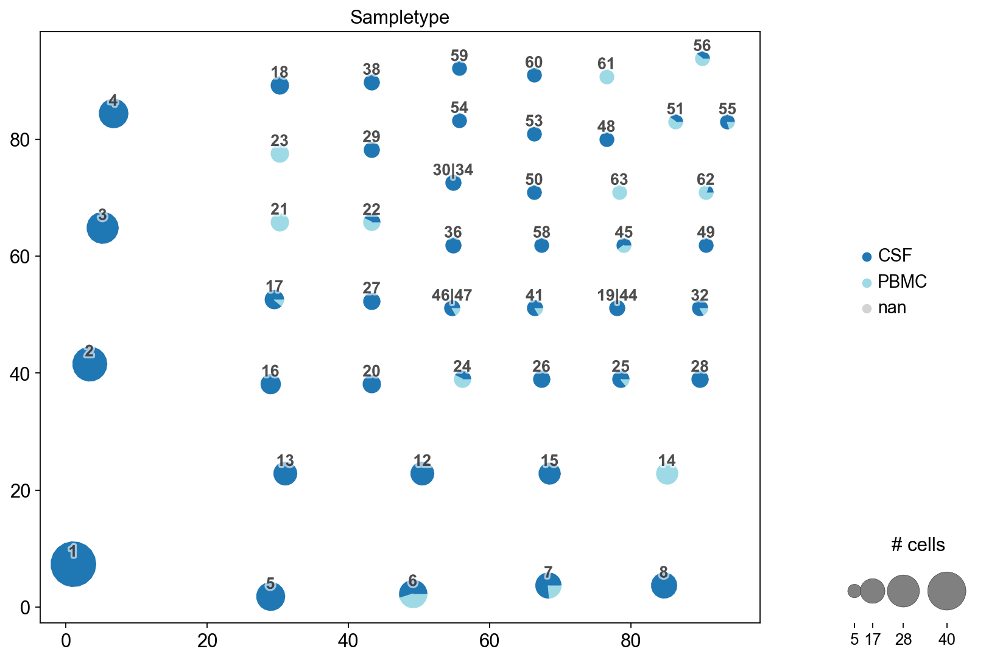

In [91]:

ir.pl.clonotype_network(adata_filtered, color="Sampletype", base_size=20, label_fontsize=12, panel_size=(10, 8))


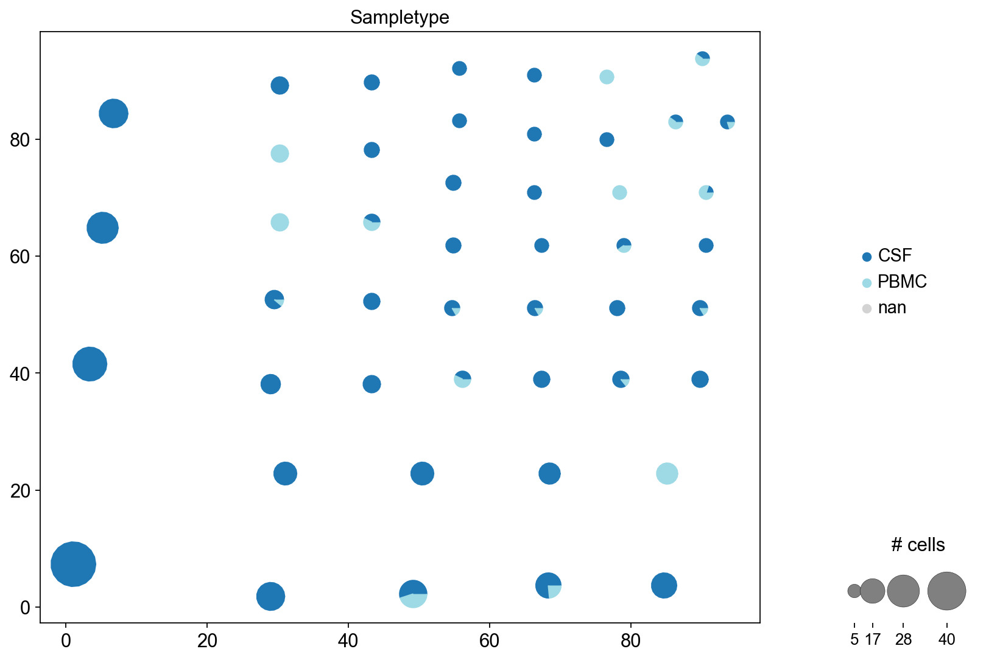

In [22]:
ir.pl.clonotype_network(adata_filtered, color="Sampletype", base_size=20, label_fontsize=12, show_labels=False, panel_size=(10, 8))


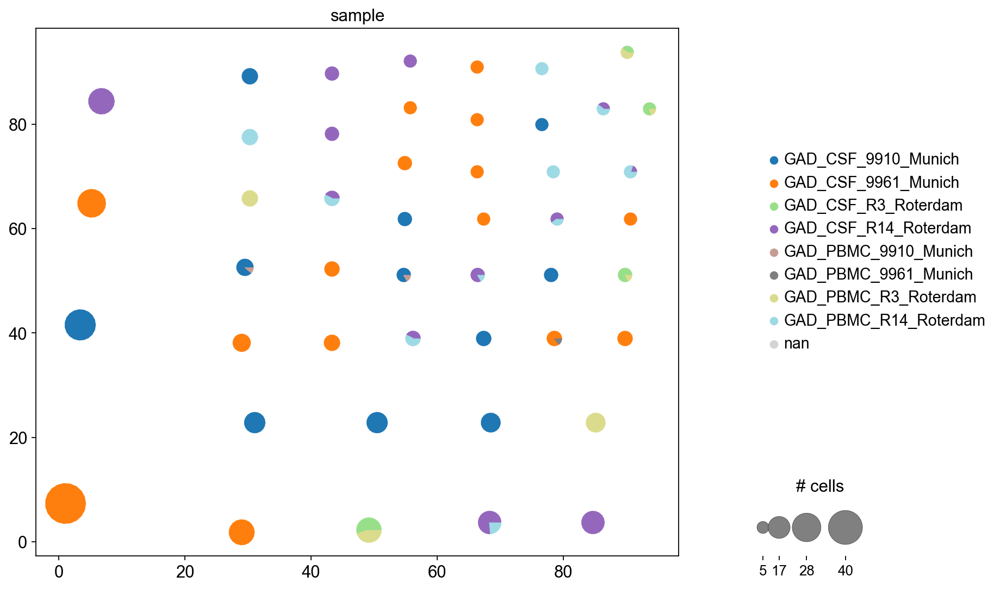

In [23]:

ir.pl.clonotype_network(adata_filtered, color="sample", base_size=20, label_fontsize=12, show_labels=False, panel_size=(10, 8))


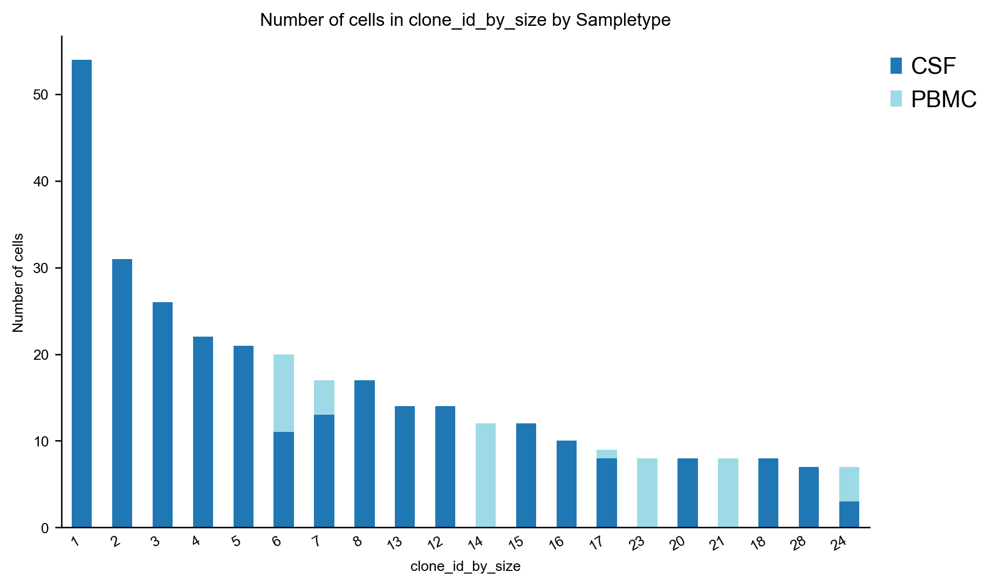

In [92]:
ir.pl.group_abundance(adata_filtered, groupby="clone_id_by_size", target_col="Sampletype", max_cols=20, figsize=(8, 5))
plt.legend(bbox_to_anchor=(1, 1), loc="upper left", frameon=False)
